# 7. ADI+IFS: PSF subtraction and forward modeling

> Author: *Valentin Christiaens*  
> Suitable for VIP *v1.2.2* onwards (**Warning** this is a different version requirement than other tutorials)  
> Last update: *2024/03/25*

**Table of contents**

* [7.1. Loading and visualizing the data](#7.1.-Loading-and-visualizing-the-data)
* [7.2. Planet parameters and spectra](#7.2.-Planet-parameters-and-spectra)
* [7.3. Flux normalization](#7.3.-Flux-normalization)
    - [7.3.1. Non-coronagraphic PSF normalization](#7.3.1.-Non-coronagraphic-PSF-normalization)
    - [7.3.2. Stellar SED model](#7.3.2.-Stellar-SED-model)
    - [7.3.3. Airmass](#7.3.3.-Airmass)
    - [7.3.4. Final fluxes](#7.3.4.-Final-fluxes)     
* [7.4. Injection](#7.4.-Injection)
* [7.5. Post-processing of IFS data](#7.5.-Post-processing-of-IFS-data)
    - [7.5.1. Optimal scaling factors](#7.5.1.-Optimal-scaling-factors)
    - [7.5.2. median-SDI](#7.5.2.-median-SDI)
    - [7.5.3. PCA-SDI](#7.5.3.-PCA-SDI)
    - [7.5.4. median-ASDI](#7.5.4.-median-ASDI)
    - [7.5.5. PCA-ASDI](#7.5.5.-PCA-ASDI)
    - [7.5.6. PCA-ADI for all spectral channels](#7.5.6.-PCA-ADI-for-all-spectral-channels)
* [7.6. Astrometry retrieval](#7.6.-Astrometry-retrieval)
    - [7.6.1. Spectral channels with maximum SNR](#7.6.1.-Spectral-channels-with-maximum-SNR)
    - [7.6.2. NEGFC+PCA-ADI (simplex)](#7.6.2.-NEGFC+PCA-ADI-(simplex))
    - [7.6.3. NEGFC+PCA-ADI (MCMC)](#7.6.3.-NEGFC+PCA-ADI-(MCMC))
* [7.7. Spectrum retrieval](#7.7.-Spectrum-retrieval)
    - [7.7.1. NEGFC+PCA-ADI (simplex)](#7.7.1.-NEGFC+PCA-ADI-(simplex))
    - [7.7.2. NEGFC+PCA-ADI (MCMC)](#7.7.2.-NEGFC+PCA-ADI-(MCMC))

The purpose of this tutorial is to show:
- how to inject a planet spectrum in a 4D (IFS+ADI) datacube;
- how to post-process 4D (IFS+ADI) datacubes; 
- how to retrieve the parameters of a planet present in a 4D (IFS+ADI) datacube (astro- and spectrometry).

<div class="alert alert-block alert-info"> 
    <b>Note: </b>
<a class="anchor" id="note1"></a>

The model spectra (for the star and planet) used in this notebook are provided after resampling for the purpose of highlighting the capabilities of VIP only (i.e. to avoid having to install additional requirements to be able to run this tutorial). If you are interested in a more complete planet spectrum injection procedure, check out [this Exoplanet Data Challenge Phase 2 tutorial](https://github.com/exoplanet-imaging-challenge/phase2/tree/main/tutorials), which also requires the following external packages: [``special``](https://github.com/VChristiaens/special) (for model resampling) and [``eidc2``](https://github.com/exoplanet-imaging-challenge/phase2) (for better flux normalization before spectrum injection).
</div>

Let's first load all packages needed in this tutorial:

In [1]:
import astropy.constants as c
import glob
from hciplot import plot_frames, plot_cubes
from matplotlib import pyplot as plt
import numpy as np
from os.path import join
import pandas as pd
from packaging import version

In the following box we check that your version of VIP passes the requirements to run this notebook:

In [2]:
import vip_hci as vip
vvip = vip.__version__
print("VIP version: ", vvip)
if version.parse(vvip) <= version.parse("1.2.2"):
    msg = "Please upgrade your version of VIP"
    msg+= "It should be above 1.2.2 to run this notebook."
    raise ValueError(msg)

VIP version:  1.6.1


## 7.1. Loading and visualizing the data

In the 'datasets' folder of the `VIP_extras` repository you can find a toy SPHERE/IFS coronagraphic cube acquired in pupil-stabilized mode on the source HIP39826 (a star with no reported directly imaged companion). The folder also contains the associated non-coronagraphic point spread function (PSF), wavelength vector, parallactic angles, and airmass of the source.

Let's now load the data. Note that more info on opening and visualizing fits files with VIP in general is available [in the first VIP tutorial](https://vip.readthedocs.io/en/latest/tutorials/01_quickstart.html).

In [3]:
from vip_hci.fits import open_fits
from astropy.utils.data import download_file

url_d = "https://github.com/vortex-exoplanet/VIP_extras/raw/master/datasets"
f1 = download_file("{}/sphere_ifs_HIP39826_cube.fits".format(url_d), cache=True)
f2 = download_file("{}/sphere_ifs_HIP39826_psf.fits".format(url_d), cache=True)
f3 = download_file("{}/sphere_ifs_HIP39826_pa.fits".format(url_d), cache=True)
f4 = download_file("{}/sphere_ifs_HIP39826_wl.fits".format(url_d), cache=True)
f5 = download_file("{}/sphere_ifs_HIP39826_airmass.fits".format(url_d), cache=True)
ftrans = download_file("{}/sphere_ifs_YJ_APLC_CoroTransmission.fits".format(url_d), cache=True)

# alternatively, for local files simply provide their full or relative path. E.g.:
#f1 = '../datasets/sphere_ifs_HIP39826_cube.fits'
#f2 = '../datasets/sphere_ifs_HIP39826_psf.fits'
#f3 = '../datasets/sphere_ifs_HIP39826_pa.fits'
#f4 = '../datasets/sphere_ifs_HIP39826_wl.fits'
#f5 = '../datasets/sphere_ifs_HIP39826_airmass.fits'

cube = open_fits(f1)
psf = open_fits(f2)
derot_angles = -1*open_fits(f3) # note: SPHERE DRH returns parallactic angles, while VIP routines take derotation angles as input
lbda = open_fits(f4)
X_sci = open_fits(f5)
trans = open_fits(ftrans)

nch, nz, ny, nx = cube.shape

FITS HDU-0 data successfully loaded. Data shape: (39, 55, 107, 107)
FITS HDU-0 data successfully loaded. Data shape: (39, 29, 29)
FITS HDU-0 data successfully loaded. Data shape: (55,)
FITS HDU-0 data successfully loaded. Data shape: (39,)
FITS HDU-0 data successfully loaded. Data shape: (55,)
FITS HDU-0 data successfully loaded. Data shape: (40, 23)


<div class="alert alert-block alert-info"> 
    <b>Note: </b>
<a class="anchor" id="det1"></a>                                       

In this example, we take the opposite of the parallactic angles provided in the FITS file, as the convention in VIP is to always consider the **derotation angles** to be applied to align North up, while the loaded angles are the direct outputs of the SPHERE data center calibration, which trace the **parallactic angles**.

</div>

Each IFS spectral cube consists of 39 monochromatic images spread in wavelengths between the Y and J bands ('YJ' mode) or Y and H bands ('YJH' mode). Here the IFS+ADI cube contains 55 such spectral cubes combined into a single master cube.

The **master spectral cube** is already centered, trimmed from bad frames, and mostly corrected from bad pixels (check Tutorial 2 for example uses). 

Let's inspect the first wavelength using `hciplot.plot_cubes` (feel free to set the backend to 'bokeh' to read pixel values interactively):

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
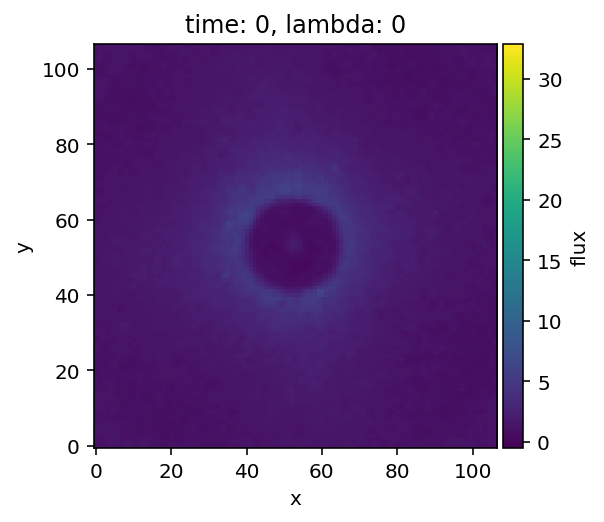

In [4]:
plot_cubes(cube)#, backend='bokeh')

We notice that the flux varies and the PSF size increases, both as a function of wavelength.

Now let's inspect the **PSF cube** (one frame per wavelength), which will be used for the actual injection of a fake planet:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
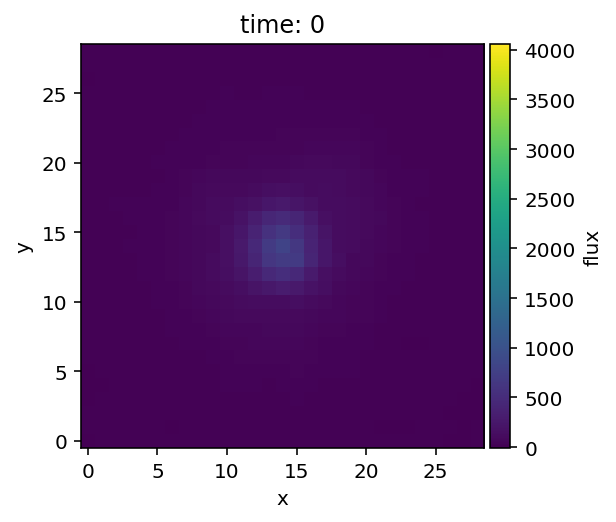

In [5]:
plot_cubes(psf)

As we can see, the flux varies as a function of wavelength. This reflects the intrinsic spectrum of the star but also the instrumental transmission and atmospheric absorption bands (e.g. associated to the water molecule) affecting some wavelengths more than others. The flux will be normalized in the next section, before injection.

Now let's check the **parallactic angle** and **airmass** variations:

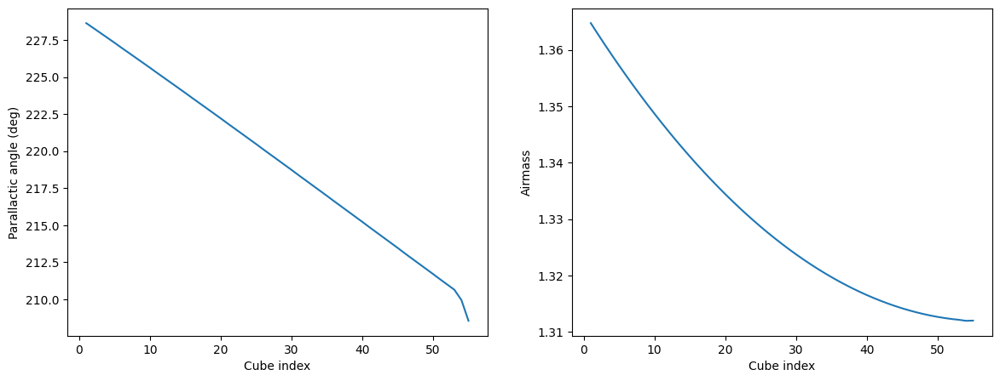

In [6]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(range(1,nz+1), derot_angles)
ax1.set_xlabel("Cube index")
ax1.set_ylabel("Parallactic angle (deg)")
ax2.plot(range(1,nz+1), X_sci)
ax2.set_xlabel("Cube index")
ax2.set_ylabel("Airmass")
plt.show()

Note the sudden variation in parallactic angle at the end of the sequence is because we trimmed bad frames from the sequence (all were located towards the end of the observation).

Let's define the **pixel scale** for IFS - note that this is optional since the planet coordinates will be given in pixels. It will still be useful to have meaningful radial separations expressed in arcsec.

In [7]:
from vip_hci.config import VLT_SPHERE_IFS
plsc = VLT_SPHERE_IFS['plsc']
print(plsc, "arcsec/px")

0.00746 arcsec/px


The coronagraphic radial **transmission** profile was loaded above and cast into the `trans` variable. Let's visualize it.

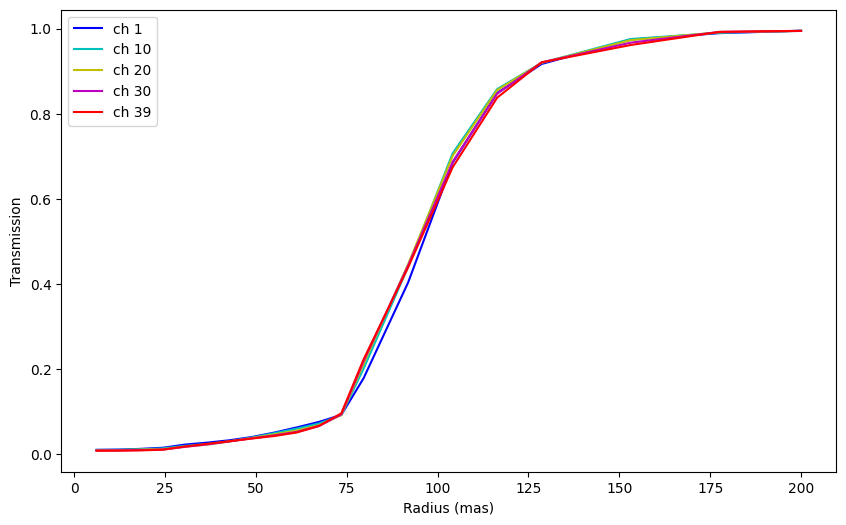

In [8]:
last_r = 20
plt.figure(figsize=(10,6))
plt.plot(trans[0,:last_r]*1000, trans[1,:last_r], 'b', label='ch 1')
plt.plot(trans[0,:last_r]*1000, trans[10,:last_r], 'c', label='ch 10')
plt.plot(trans[0,:last_r]*1000, trans[20,:last_r], 'y', label='ch 20')
plt.plot(trans[0,:last_r]*1000, trans[30,:last_r], 'm', label='ch 30')
plt.plot(trans[0,:last_r]*1000, trans[-1,:last_r], 'r', label='ch 39')
plt.xlabel("Radius (mas)")
plt.ylabel("Transmission")
plt.legend()

<div class="alert alert-block alert-danger"> 
    <b>Caution: </b>
<a class="anchor" id="note1"></a>

This is not the most up-to-date SPHERE coronagraphic transmission curve. Please contact relevant SPHERE colleagues or check the ESO website for a newer version. Do not use the above curve for your research.
</div>

## 7.2. Planet parameters and spectra

Now let's set the **ground truth coordinates** and average **contrast** (over all wavelengths) at which two planets will be injected in this cube:

In [9]:
xy_b = (58.6,37.7)
contrast_b = 1e-3

xy_c = (83.8,29.9)
contrast_c = 2e-4

Let's convert cartesian to polar coordinates:

In [10]:
from vip_hci.var import frame_center, dist

cy, cx = frame_center(cube)
r_b = dist(cy, cx, xy_b[1], xy_b[0])
r_c = dist(cy, cx, xy_c[1], xy_c[0])

theta_b = np.rad2deg(np.arctan2(xy_b[1]-cy, xy_b[0]-cx))
theta_c = np.rad2deg(np.arctan2(xy_c[1]-cy, xy_c[0]-cx))

In [11]:
print(cy, cx)
print(r_b, theta_b)
print(r_c, theta_c)

53 53
16.292636373527763 -69.89671372878468
38.5 -36.86989764584403


Now let's consider two fiducial model spectra for the injection of the 2 planets: a flat spectrum and a **1000K blackbody model** (note that this exercise is purely academic).

In [12]:
def blackbody(lbda, T): 
    fac = 2*c.h.value*(c.c.value**2)/(np.power(lbda*1e-6,5))
    div = (1/(np.exp((c.h.value*c.c.value)/((lbda*1e-6)*c.k_B.value*T))-1))
    # convert from W m-3 Sr-1 to W m-2 mu-1 Sr-1 
    conv = 1e-6
    return fac*div*conv

In [13]:
fluxes_b = np.ones_like(lbda)
fluxes_c = blackbody(lbda, 1000)

spec_b = np.array([lbda, fluxes_b])
spec_c = np.array([lbda, fluxes_c])

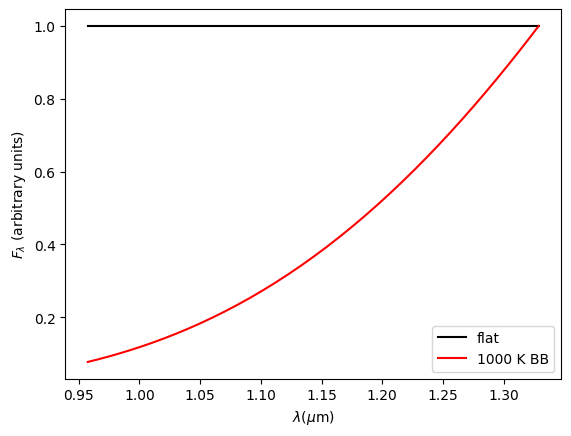

In [14]:
plt.plot(lbda, fluxes_b/np.amax(fluxes_b), 'k', label='flat')
plt.plot(lbda, fluxes_c/np.amax(fluxes_c), 'r', label='1000 K BB')
plt.xlabel(r"$\lambda (\mu$m)")
plt.ylabel(r"$ F_{\lambda}$ (arbitrary units)")
plt.legend()

## 7.3. Flux normalization

### 7.3.1. Non-coronagraphic PSF normalization

Let's measure the flux and FWHM of the non-coronagraphic PSF and normalize its flux to 1 in a 1-FWHM radius aperture (all at once), in all channels, using VIP's `fm/normalize_psf` function. We use the `debug` option to check that each 2D Gaussian fit worked properly:

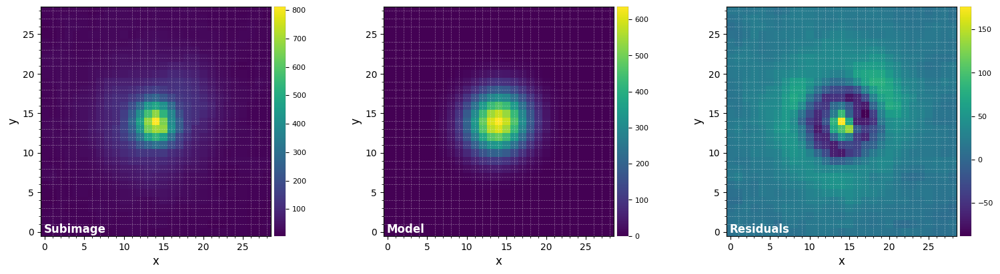

FWHM_y = 6.249918590603874
FWHM_x = 5.955174570808004 

centroid y = 13.91271280451398
centroid x = 13.899308522396119
centroid y subim = 13.91271280451398
centroid x subim = 13.899308522396119 

amplitude = 636.3209207163183
theta = -40.20327494893465


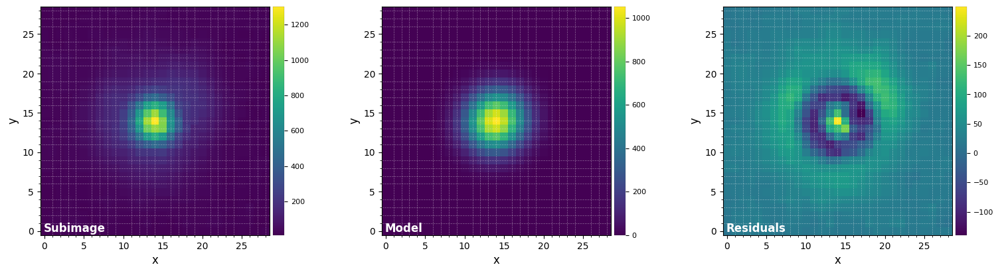

FWHM_y = 6.115031733429569
FWHM_x = 5.839092912200307 

centroid y = 14.027611189747118
centroid x = 13.902123414264741
centroid y subim = 14.027611189747118
centroid x subim = 13.902123414264741 

amplitude = 1054.2949916060757
theta = -37.53607125551694


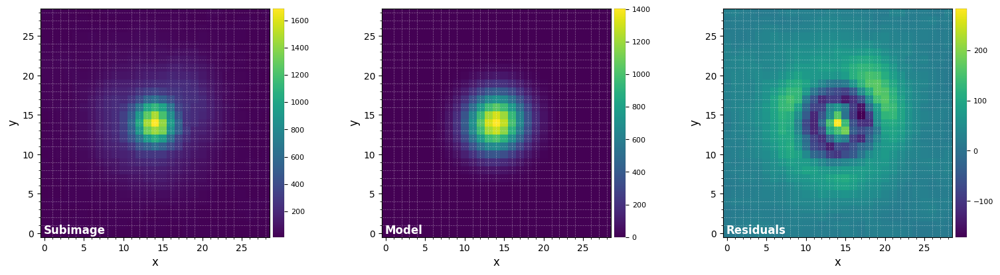

FWHM_y = 6.017536940985172
FWHM_x = 5.754055056932398 

centroid y = 14.064675014829234
centroid x = 13.92189940782827
centroid y subim = 14.064675014829234
centroid x subim = 13.92189940782827 

amplitude = 1404.794695125425
theta = -32.75340696040902


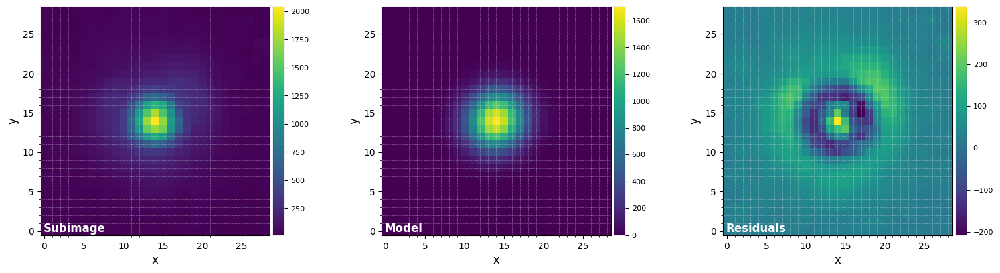

FWHM_y = 5.991878155204902
FWHM_x = 5.682647009421292 

centroid y = 14.065184394206566
centroid x = 13.946038597175642
centroid y subim = 14.065184394206566
centroid x subim = 13.946038597175642 

amplitude = 1705.2716467835362
theta = -37.38382831173306


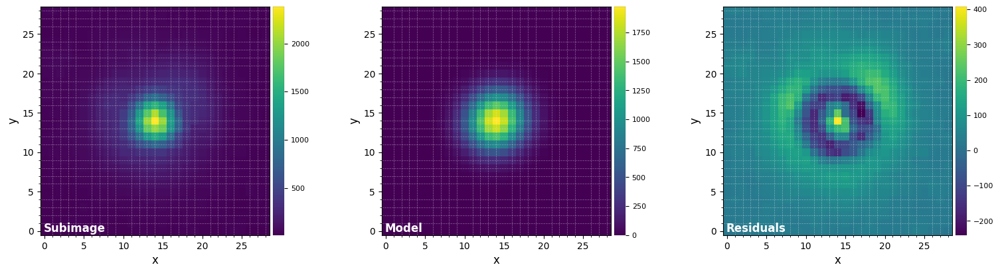

FWHM_y = 6.025210456840216
FWHM_x = 5.719302651409165 

centroid y = 14.075784813017492
centroid x = 13.955473078460203
centroid y subim = 14.075784813017492
centroid x subim = 13.955473078460203 

amplitude = 1975.512023781219
theta = -39.22716810162712


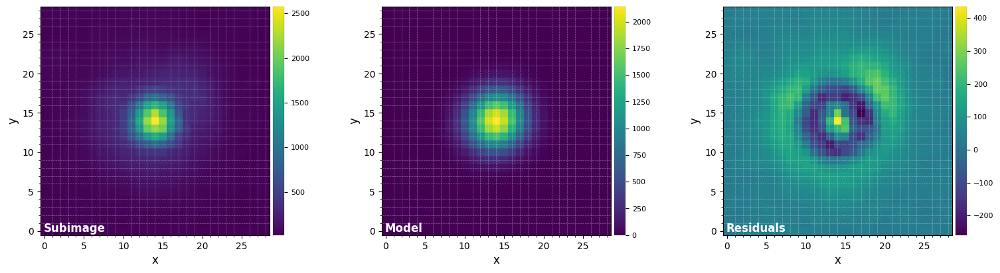

FWHM_y = 5.985037638845695
FWHM_x = 5.719904342290713 

centroid y = 14.090563585852339
centroid x = 13.954901979145369
centroid y subim = 14.090563585852339
centroid x subim = 13.954901979145369 

amplitude = 2143.9966998784653
theta = -37.89243906967077


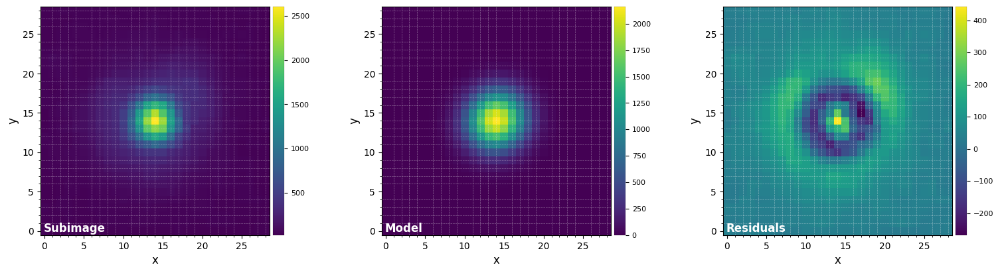

FWHM_y = 6.037449649433551
FWHM_x = 5.753733367061057 

centroid y = 14.109510955089712
centroid x = 13.980317492176528
centroid y subim = 14.109510955089712
centroid x subim = 13.980317492176528 

amplitude = 2165.8668020759737
theta = -38.98816537803609


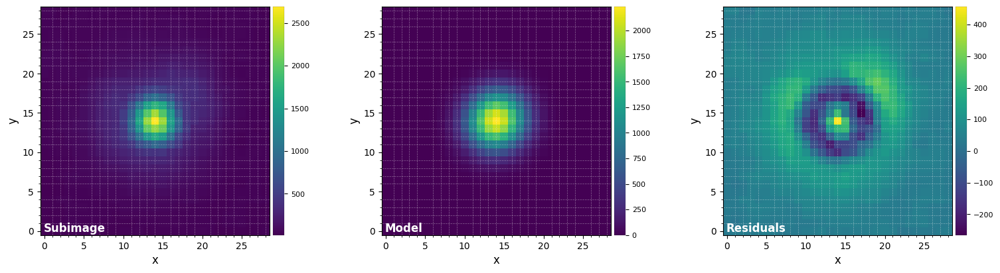

FWHM_y = 6.010425979656497
FWHM_x = 5.749988204486838 

centroid y = 14.09139902516843
centroid x = 13.986593684665714
centroid y subim = 14.09139902516843
centroid x subim = 13.986593684665714 

amplitude = 2237.452674183443
theta = -42.082555609402725


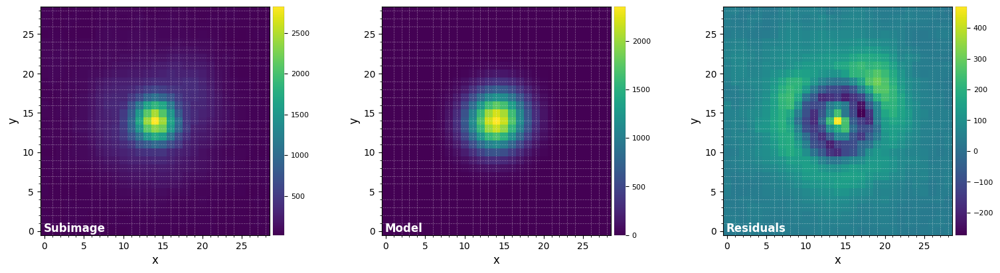

FWHM_y = 6.005151597188339
FWHM_x = 5.76618913736032 

centroid y = 14.090254937281216
centroid x = 14.000261828564383
centroid y subim = 14.090254937281216
centroid x subim = 14.000261828564383 

amplitude = 2355.107335363224
theta = -38.12872688402823


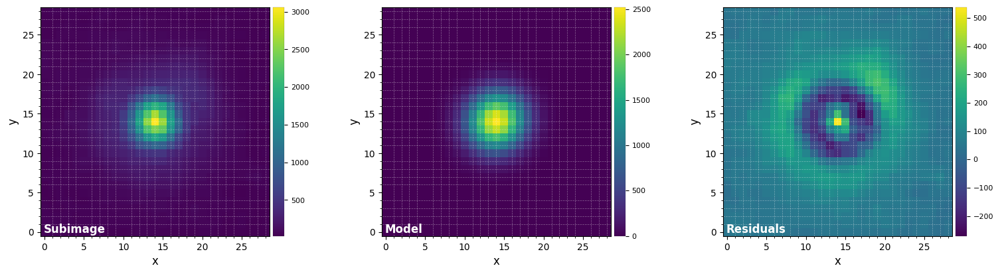

FWHM_y = 5.968097471114103
FWHM_x = 5.732989798767101 

centroid y = 14.102026780112466
centroid x = 14.00192256597961
centroid y subim = 14.102026780112466
centroid x subim = 14.00192256597961 

amplitude = 2523.9552216610077
theta = -36.166718794700735


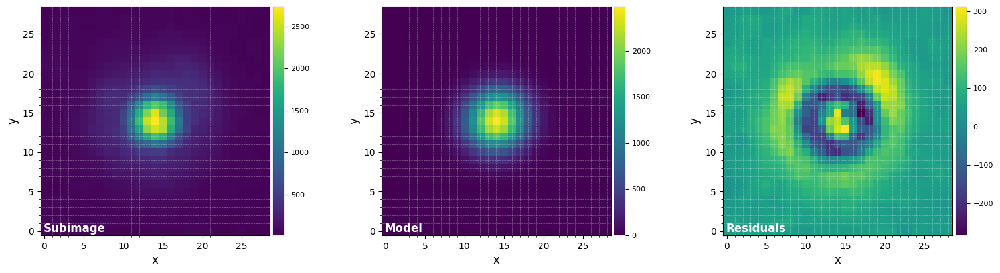

FWHM_y = 6.201045253077615
FWHM_x = 5.952529125955214 

centroid y = 14.095618864845
centroid x = 14.011238141279225
centroid y subim = 14.095618864845
centroid x subim = 14.011238141279225 

amplitude = 2483.278573203233
theta = -40.0145330658136


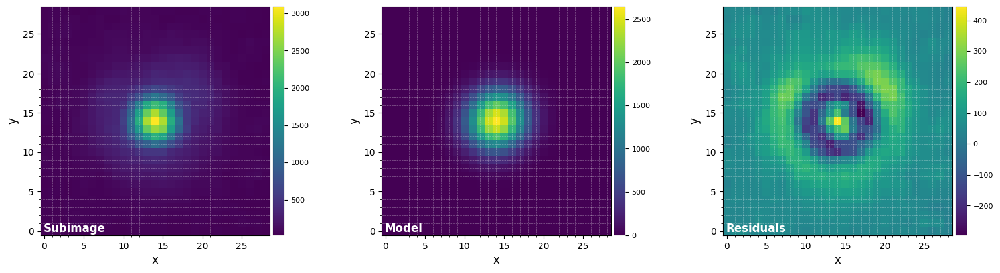

FWHM_y = 6.116743999603686
FWHM_x = 5.8392716209686455 

centroid y = 14.100847253492372
centroid x = 14.00962801008164
centroid y subim = 14.100847253492372
centroid x subim = 14.00962801008164 

amplitude = 2649.287384055851
theta = -42.97211525263866


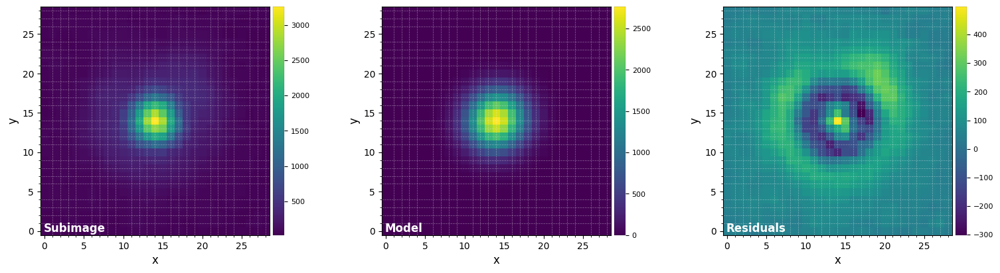

FWHM_y = 6.037056836634695
FWHM_x = 5.786392745945851 

centroid y = 14.110142788418528
centroid x = 14.004784235107898
centroid y subim = 14.110142788418528
centroid x subim = 14.004784235107898 

amplitude = 2770.0240285986383
theta = -39.87700223679414


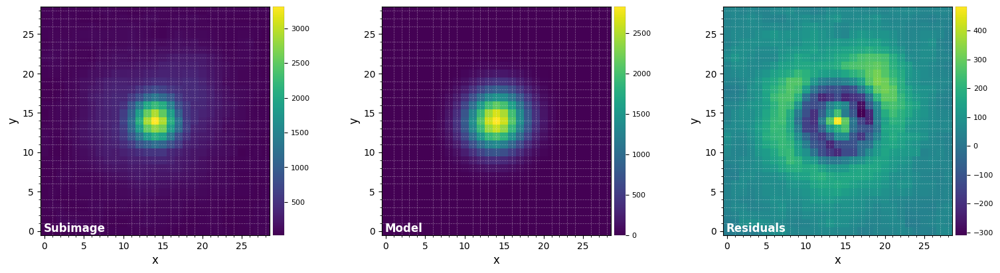

FWHM_y = 6.066318706454739
FWHM_x = 5.822724547903064 

centroid y = 14.099317823674594
centroid x = 14.003150239115127
centroid y subim = 14.099317823674594
centroid x subim = 14.003150239115127 

amplitude = 2830.2548549551825
theta = -47.81201831706728


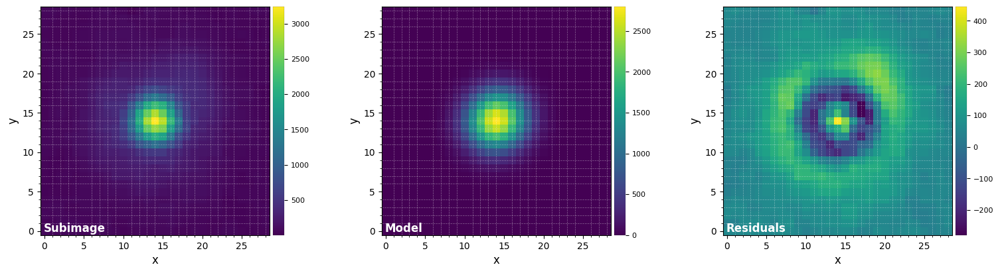

FWHM_y = 6.0762534866894
FWHM_x = 5.806486874018672 

centroid y = 14.112521461447967
centroid x = 14.034377198494248
centroid y subim = 14.112521461447967
centroid x subim = 14.034377198494248 

amplitude = 2803.4053532338025
theta = -1130.8992713799976


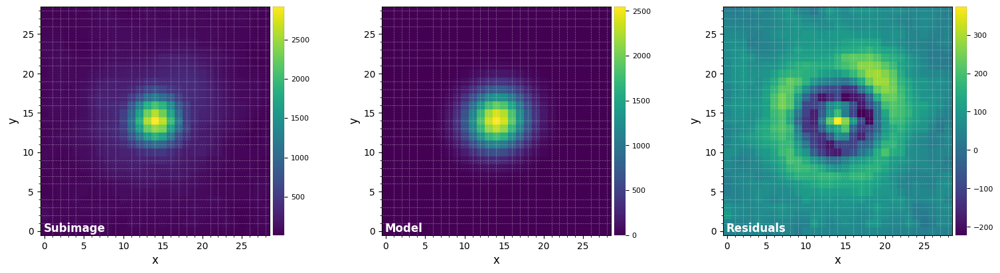

FWHM_y = 5.783408275201281
FWHM_x = 6.0947688987153565 

centroid y = 14.151451482312362
centroid x = 14.046235885495358
centroid y subim = 14.151451482312362
centroid x subim = 14.046235885495358 

amplitude = 2553.3202894435076
theta = -1046.1876651444495


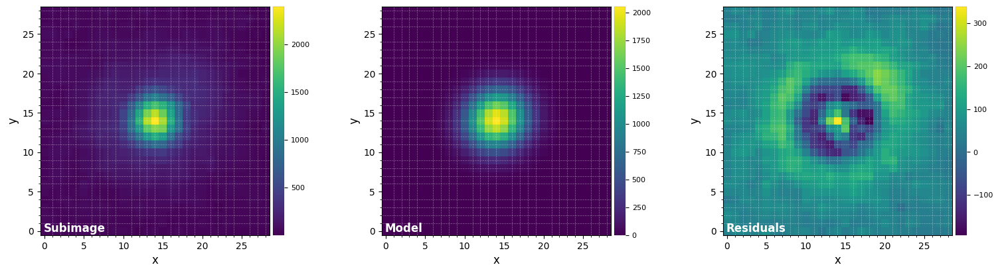

FWHM_y = 6.181608409176731
FWHM_x = 5.8193909573736375 

centroid y = 14.20606445385617
centroid x = 14.027564827140305
centroid y subim = 14.20606445385617
centroid x subim = 14.027564827140305 

amplitude = 2063.199046760751
theta = -591.897110332275


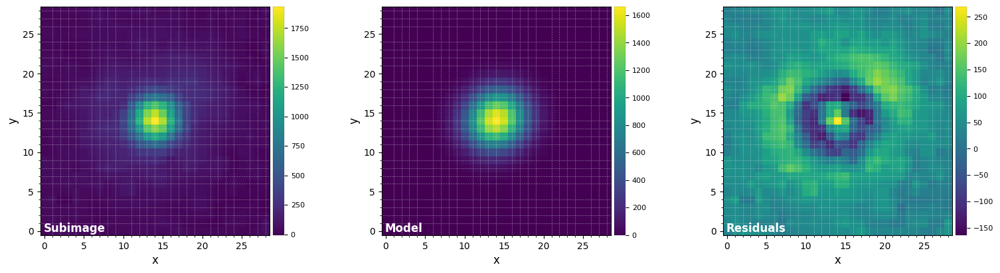

FWHM_y = 5.751799509227016
FWHM_x = 6.17657549885813 

centroid y = 14.19949897448417
centroid x = 14.014692740126705
centroid y subim = 14.19949897448417
centroid x subim = 14.014692740126705 

amplitude = 1668.583800683618
theta = 214.19574589903868


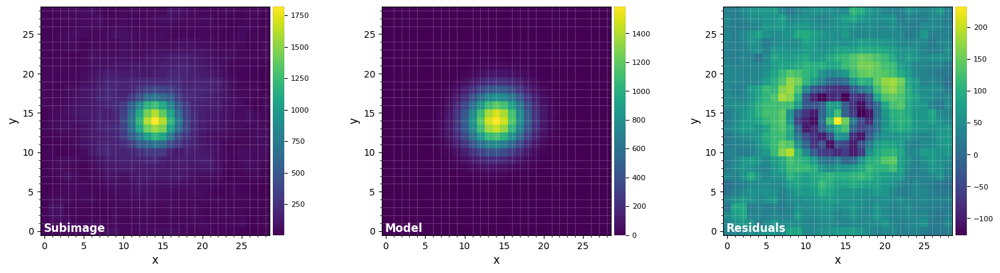

FWHM_y = 5.797247573087523
FWHM_x = 6.1407206833700165 

centroid y = 14.09188009914479
centroid x = 13.978278484577537
centroid y subim = 14.09188009914479
centroid x subim = 13.978278484577537 

amplitude = 1587.9799968312032
theta = 208.93362670690016


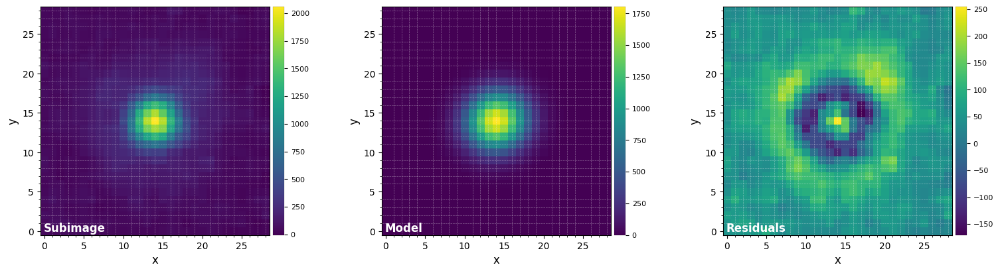

FWHM_y = 6.173286713166213
FWHM_x = 5.849770266197921 

centroid y = 14.020275158086994
centroid x = 14.002567343397786
centroid y subim = 14.020275158086994
centroid x subim = 14.002567343397786 

amplitude = 1805.5945901482098
theta = 117.55114919185255


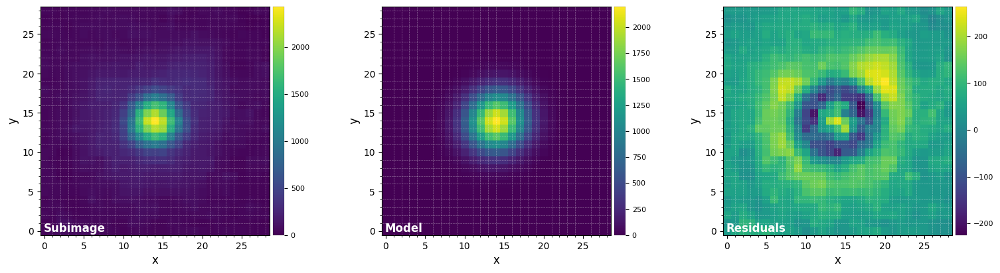

FWHM_y = 5.8792339430596385
FWHM_x = 6.127221726103625 

centroid y = 13.989753883492577
centroid x = 14.002807252408369
centroid y subim = 13.989753883492577
centroid x subim = 14.002807252408369 

amplitude = 2198.15726732781
theta = -320.2155668333245


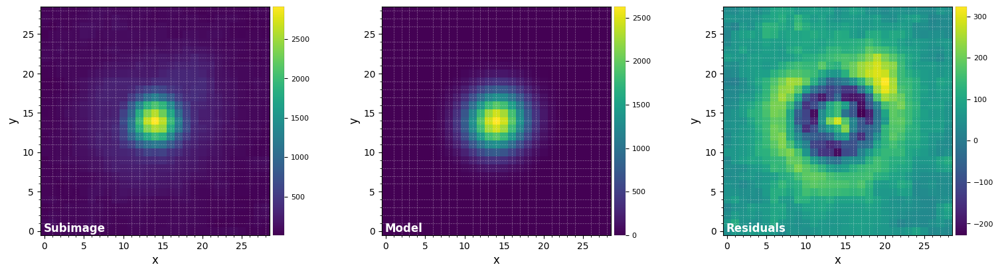

FWHM_y = 5.887171922875942
FWHM_x = 6.160164896057722 

centroid y = 14.006124941599417
centroid x = 14.009936779590372
centroid y subim = 14.006124941599417
centroid x subim = 14.009936779590372 

amplitude = 2628.450008946031
theta = -321.35901701076017


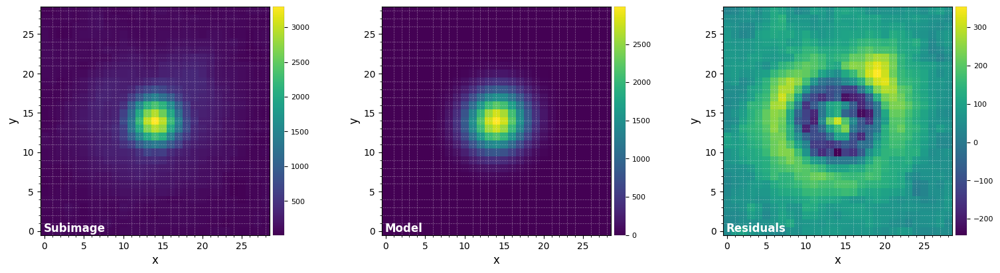

FWHM_y = 6.09831937562108
FWHM_x = 5.823811534748941 

centroid y = 14.045780781152429
centroid x = 14.014771011818317
centroid y subim = 14.045780781152429
centroid x subim = 14.014771011818317 

amplitude = 2992.2717122916088
theta = -228.95610739084978


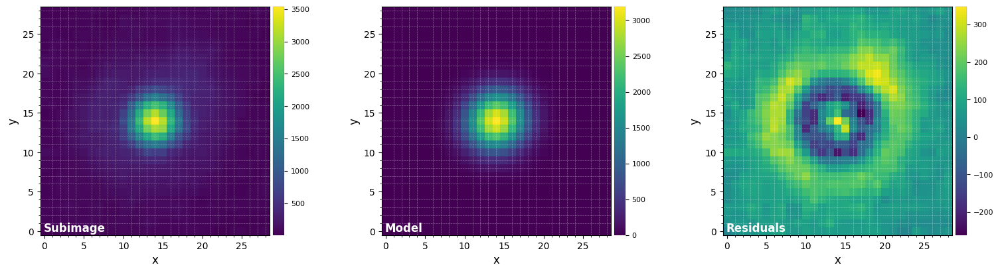

FWHM_y = 6.0881435225079805
FWHM_x = 5.800320948866406 

centroid y = 14.051247831816042
centroid x = 13.998093842075047
centroid y subim = 14.051247831816042
centroid x subim = 13.998093842075047 

amplitude = 3191.2868185639486
theta = -409.9397195034933


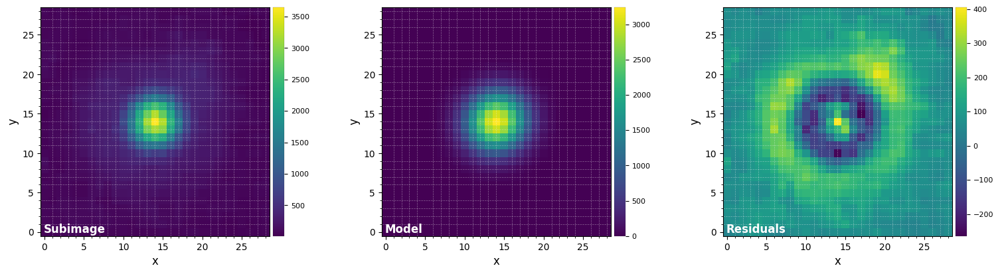

FWHM_y = 6.131166433598984
FWHM_x = 5.872212732710024 

centroid y = 14.035337815438458
centroid x = 13.998171477355866
centroid y subim = 14.035337815438458
centroid x subim = 13.998171477355866 

amplitude = 3243.165884637672
theta = -50.094032052651244


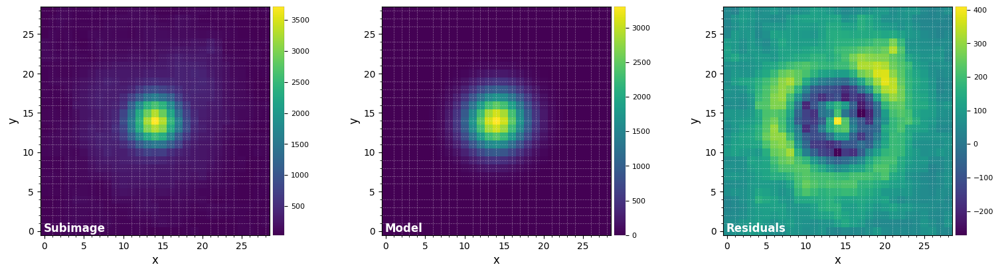

FWHM_y = 6.174942665281358
FWHM_x = 5.993212466027066 

centroid y = 14.039753518531834
centroid x = 13.991921001228043
centroid y subim = 14.039753518531834
centroid x subim = 13.991921001228043 

amplitude = 3307.870326350025
theta = -60.77852495501218


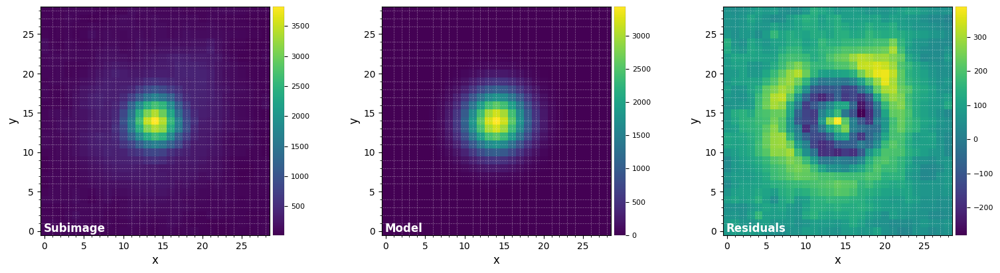

FWHM_y = 6.212946741792123
FWHM_x = 6.032862559194067 

centroid y = 14.009742407110084
centroid x = 13.967991908928983
centroid y subim = 14.009742407110084
centroid x subim = 13.967991908928983 

amplitude = 3436.0292572548005
theta = -233.07434375115434


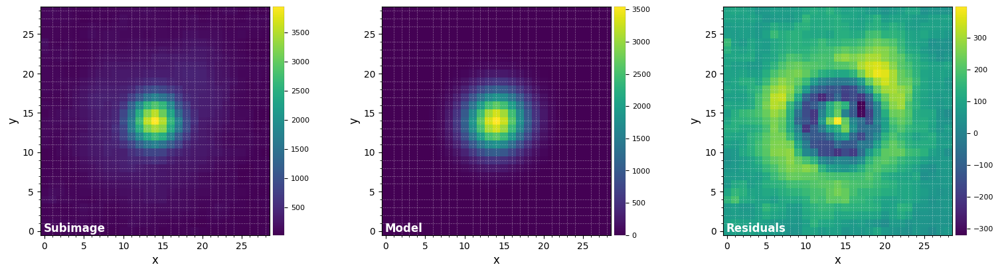

FWHM_y = 6.202834710260401
FWHM_x = 5.991454580720095 

centroid y = 14.020014512644996
centroid x = 13.952064722408837
centroid y subim = 14.020014512644996
centroid x subim = 13.952064722408837 

amplitude = 3546.6560417516
theta = -45.08873954759156


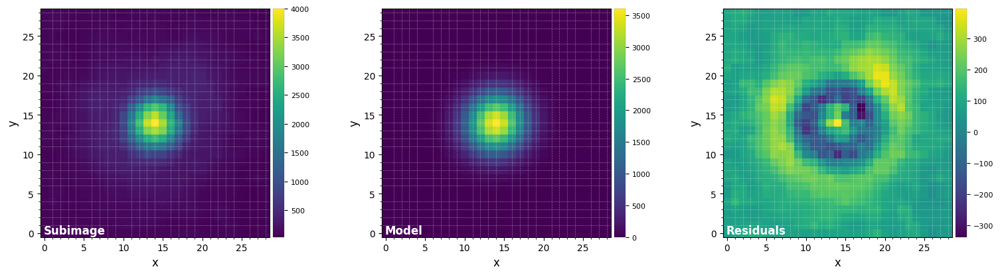

FWHM_y = 6.188582125824741
FWHM_x = 5.985402654686102 

centroid y = 14.01288592814225
centroid x = 13.933314914222532
centroid y subim = 14.01288592814225
centroid x subim = 13.933314914222532 

amplitude = 3607.1363107135303
theta = -45.54255278702471


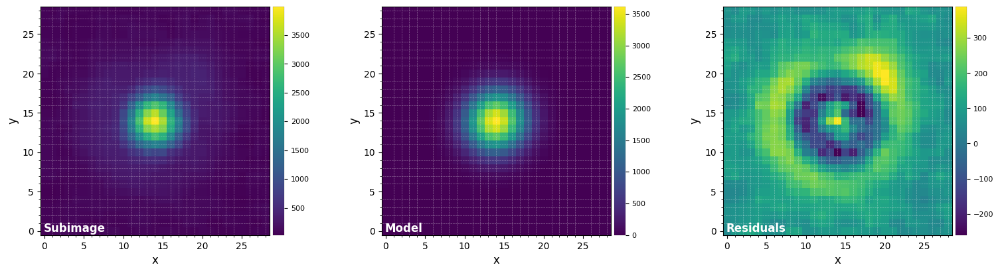

FWHM_y = 6.244755229547681
FWHM_x = 6.022172272874139 

centroid y = 14.005908973811751
centroid x = 13.928682611420811
centroid y subim = 14.005908973811751
centroid x subim = 13.928682611420811 

amplitude = 3616.190962501067
theta = -32.925763043061316


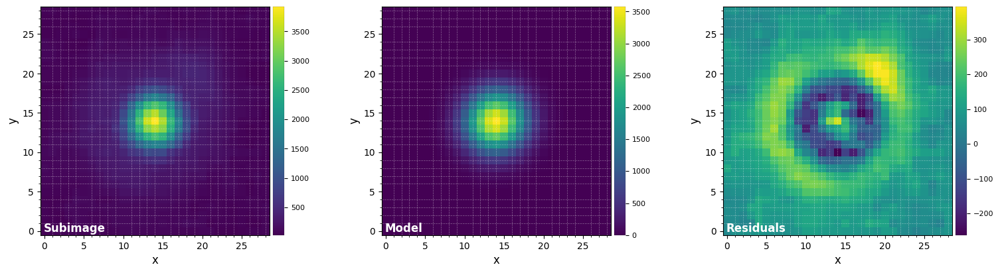

FWHM_y = 6.273041721822999
FWHM_x = 6.080609549848098 

centroid y = 13.982299985252563
centroid x = 13.934886096628695
centroid y subim = 13.982299985252563
centroid x subim = 13.934886096628695 

amplitude = 3579.5485931779963
theta = -38.81094688171014


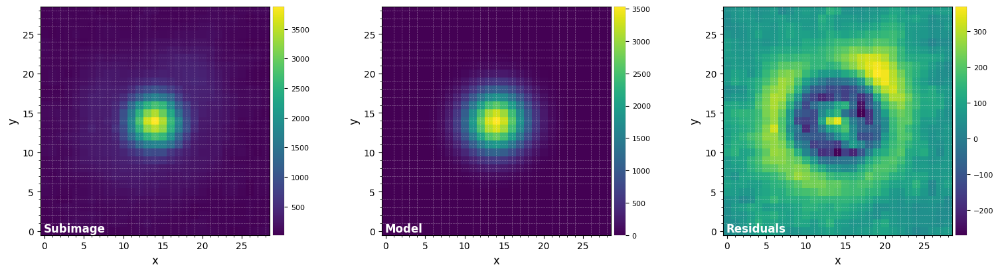

FWHM_y = 6.272897782073148
FWHM_x = 6.150604153616258 

centroid y = 13.949986873367504
centroid x = 13.940065010491569
centroid y subim = 13.949986873367504
centroid x subim = 13.940065010491569 

amplitude = 3535.362591691256
theta = -1487.0522520173815


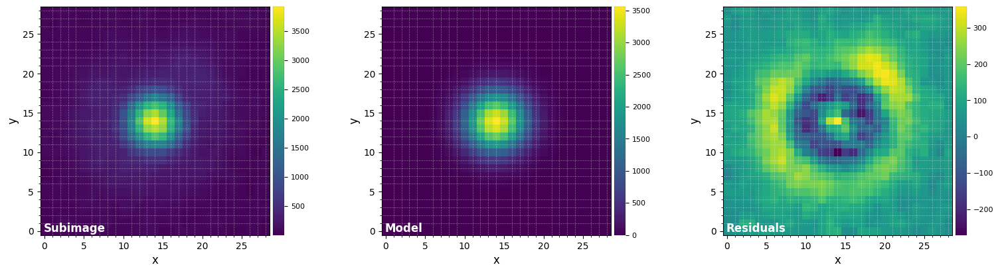

FWHM_y = 6.169653553625252
FWHM_x = 6.268150616054396 

centroid y = 13.93102667705402
centroid x = 13.920174694300993
centroid y subim = 13.93102667705402
centroid x subim = 13.920174694300993 

amplitude = 3562.2524885100333
theta = 32.84281796852152


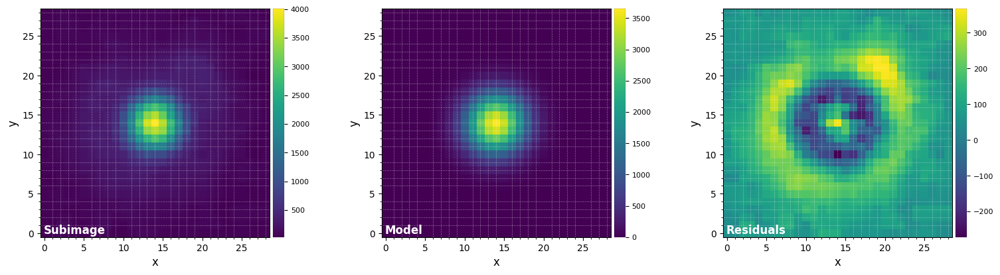

FWHM_y = 6.274537554461365
FWHM_x = 6.15783778729409 

centroid y = 13.934250084708731
centroid x = 13.921697907180066
centroid y subim = 13.934250084708731
centroid x subim = 13.921697907180066 

amplitude = 3655.6640709273543
theta = 129.0032036748455


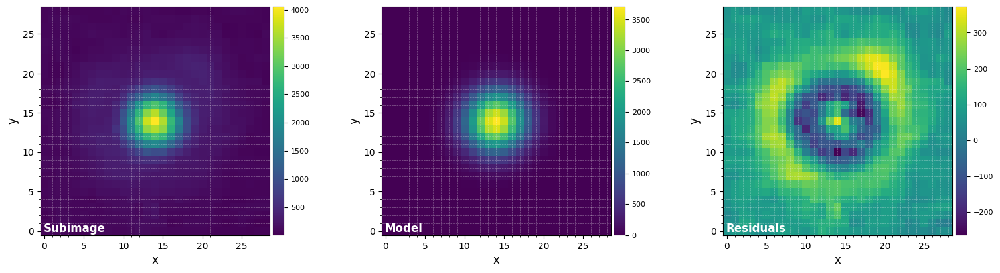

FWHM_y = 6.311436197883887
FWHM_x = 6.13531584749999 

centroid y = 13.94518468204029
centroid x = 13.904558439173428
centroid y subim = 13.94518468204029
centroid x subim = 13.904558439173428 

amplitude = 3713.2225587915073
theta = -41.34373753295229


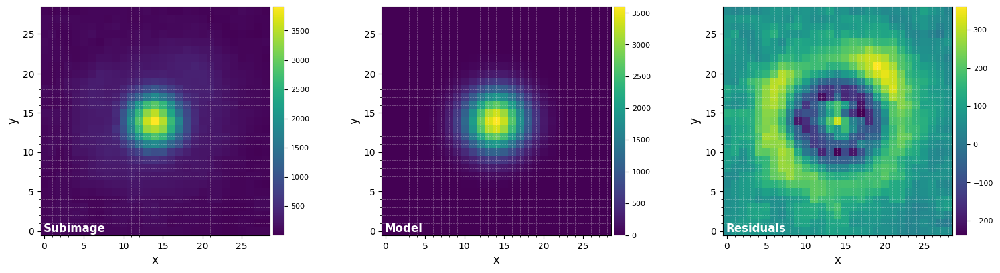

FWHM_y = 6.330588326064803
FWHM_x = 6.183593806778592 

centroid y = 13.972693149768391
centroid x = 13.88644208061843
centroid y subim = 13.972693149768391
centroid x subim = 13.88644208061843 

amplitude = 3603.9831791184242
theta = -39.620902361371115


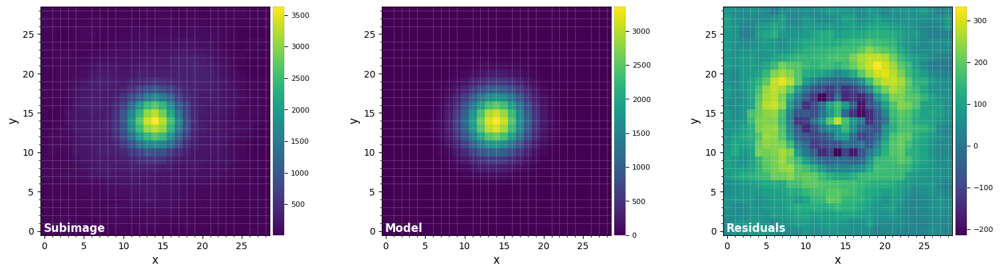

FWHM_y = 6.184001319791858
FWHM_x = 6.343494125581092 

centroid y = 13.949799213255506
centroid x = 13.88297982179931
centroid y subim = 13.949799213255506
centroid x subim = 13.88297982179931 

amplitude = 3362.492784983323
theta = -131.56407953215054


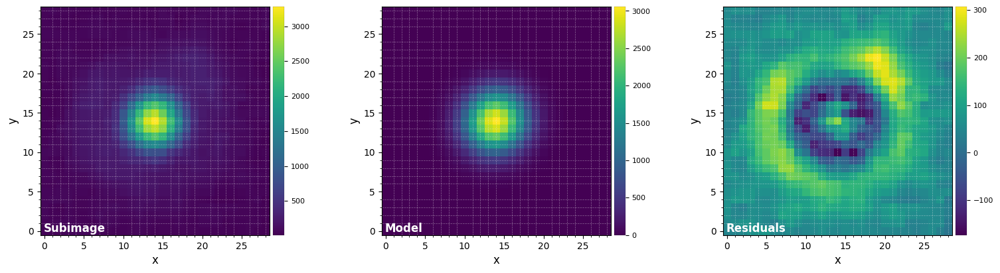

FWHM_y = 6.1049383638073556
FWHM_x = 6.326105627594453 

centroid y = 13.96352838089737
centroid x = 13.869285619427107
centroid y subim = 13.96352838089737
centroid x subim = 13.869285619427107 

amplitude = 3062.496146821083
theta = -498.2520143063228


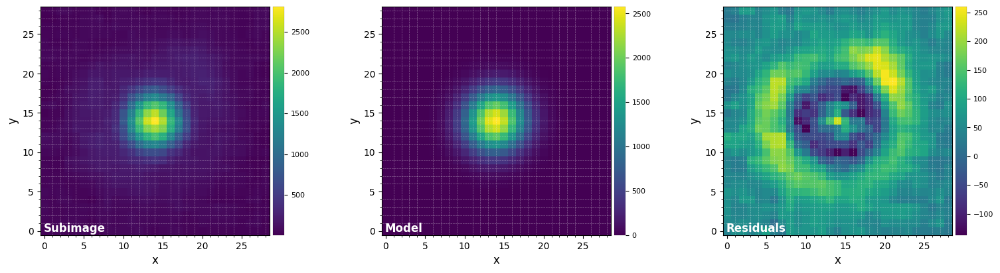

FWHM_y = 6.281872522406608
FWHM_x = 6.106896271693318 

centroid y = 14.035165570900137
centroid x = 13.854666632371053
centroid y subim = 14.035165570900137
centroid x subim = 13.854666632371053 

amplitude = 2583.8408147326386
theta = -35.599440361956056
Mean FWHM per channel: 
[6.103 5.977 5.886 5.837 5.872 5.852 5.896 5.88  5.886 5.851 6.077 5.978
 5.912 5.945 5.941 5.939 6.    5.964 5.969 6.012 6.003 6.024 5.961 5.944
 6.002 6.084 6.123 6.097 6.087 6.133 6.177 6.212 6.219 6.216 6.223 6.257
 6.264 6.216 6.194]
Flux in 1xFWHM aperture: 
[13397.649 21373.517 27661.433 33057.763 38754.981 41781.661 42805.645
 44021.68  46395.703 49082.614 52371.307 53918.696 55093.806 56930.742
 56350.541 51298.303 42189.297 33733.493 32181.659 37142.073 45223.932
 54394.967 60556.863 64201.073 66477.378 69675.456 73203.718 74978.343
 76002.683 77311.678 77583.749 77448.172 78182.432 80187.787 81616.948
 80114.272 74899.496 67091.761 56185.008]


In [15]:
from vip_hci.fm import normalize_psf
%matplotlib inline
psfn, flux_st, fwhm = normalize_psf(psf, fwhm='fit', full_output=True, debug=True)

Now let's plot the measured FWHM and stellar flux:

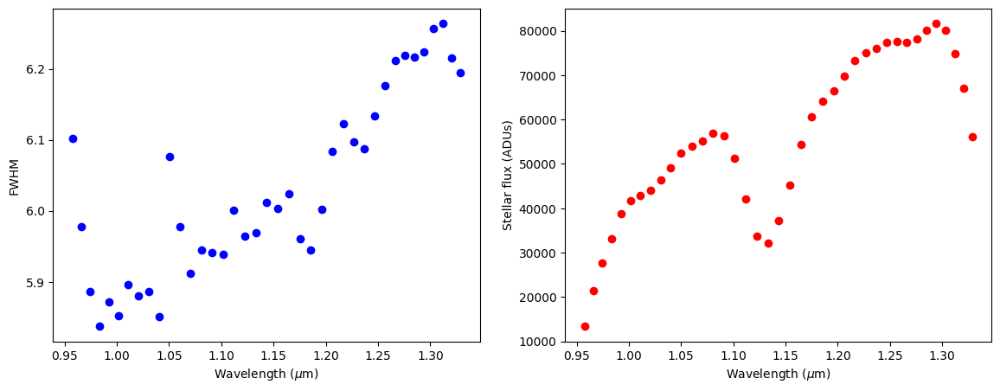

In [16]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, fwhm, 'bo')
ax1.set_xlabel(r"Wavelength ($\mu$m)")
ax1.set_ylabel("FWHM")
ax2.plot(lbda, flux_st, 'ro')
ax2.set_xlabel(r"Wavelength ($\mu$m)")
ax2.set_ylabel("Stellar flux (ADUs)")
plt.show()

**Fig. 3.1**: Measured FWHM and stellar flux in the non-coronagraphic PSF cube.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
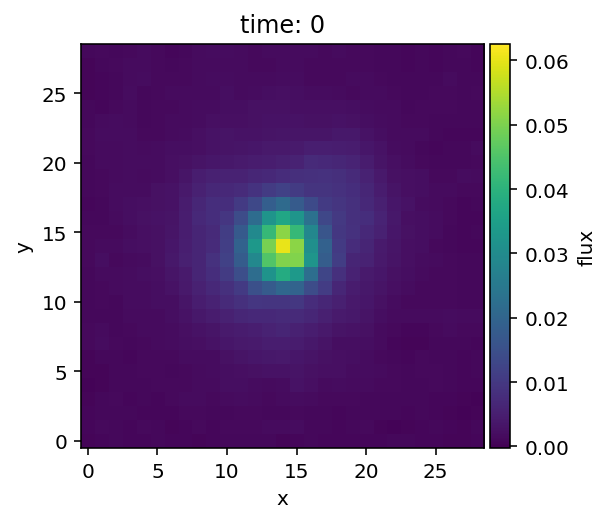

In [17]:
plot_cubes(psfn, grid=True)

Now let's save the measured spectrum of the star in the format we will need for the injection function:

In [18]:
spec_star = np.array([lbda, flux_st])

### 7.3.2. Stellar SED model

The spectral type of the star (HIP39826) is K7V. For the purpose of this tutorial, we simply load a BT-NextGen SED model that has already be resampled considering the spectral resolution and sampling of SPHERE-IFS:

In [19]:
spec_star_mod = open_fits("../datasets/sphere_ifs_HIP39826_SED_model.fits")

plt.plot(spec_star_mod[0], spec_star_mod[0]*spec_star_mod[1], 'k', label='Model SED for the star')
plt.ylabel(r"$\lambda F_{\lambda}$ (arbitrary units)")
plt.legend()

FITS HDU-0 data successfully loaded. Data shape: (2, 39)


### 7.3.3. Airmass

Airmass variation can also be taken into consideration during the injection of the planet spectra (more specifically we consider the ratio between individual airmass values and the median airmass over the observation):

In [20]:
med_X = np.median(X_sci)
X_fac = np.exp(-(X_sci-med_X))

Let's plot the factors to be applied to correct for airmass (w.r.t median airmass):

In [21]:
%matplotlib inline
plt.plot(range(1,nz+1), X_fac, 'k')
plt.xlabel("Cube index")
plt.ylabel("X factor")

Text(25.097222222222214, 0.5, 'X factor')

### 7.3.4. Final fluxes

Let's now calculate the fluxes at which the normalized PSF will actually be injected in each frame of each spectral cube.

Considering the effect of instrumental and atmospheric transmission, we have:

In [22]:
flux_b_trans = fluxes_b*(flux_st/spec_star_mod[1])
flux_c_trans = fluxes_c*(flux_st/spec_star_mod[1])                     

Considering the actual mean contrast we want the planet to be injected, with respect to the star, we have:

In [23]:
flux_b_scal = flux_b_trans*contrast_b*np.mean(flux_st)/np.mean(flux_b_trans)
flux_c_scal = flux_c_trans*contrast_c*np.mean(flux_st)/np.mean(flux_c_trans) 

Finally let's consider the airmass:

In [24]:
final_fluxes_b = np.outer(flux_b_scal, X_fac)
final_fluxes_c = np.outer(flux_c_scal, X_fac)

<div class="alert alert-block alert-info"> 
    <b>Note: </b>
<a class="anchor" id="note1"></a>

The effect of **coronagraphic** transmission is taken at the moment of injection, within the planet injection function (next section), as it depends on the radial separation from the star.
</div>

## 7.4. Injection

The actual injection can be simply performed with the `cube_inject_companions` function, which can handle 4D input cubes. Let's inject the first planet first:

In [25]:
from vip_hci.fm import cube_inject_companions
cube_fc = cube_inject_companions(cube, psfn, derot_angles, flevel=final_fluxes_b, 
                                 plsc=plsc, rad_dists=[r_b], n_branches=1, 
                                 theta=theta_b, transmission=trans, verbose=True)

*** Processing spectral channel 1/39 ***
*** Processing spectral channel 2/39 ***
*** Processing spectral channel 3/39 ***
*** Processing spectral channel 4/39 ***
*** Processing spectral channel 5/39 ***
*** Processing spectral channel 6/39 ***
*** Processing spectral channel 7/39 ***
*** Processing spectral channel 8/39 ***
*** Processing spectral channel 9/39 ***
*** Processing spectral channel 10/39 ***
*** Processing spectral channel 11/39 ***
*** Processing spectral channel 12/39 ***
*** Processing spectral channel 13/39 ***
*** Processing spectral channel 14/39 ***
*** Processing spectral channel 15/39 ***
*** Processing spectral channel 16/39 ***
*** Processing spectral channel 17/39 ***
*** Processing spectral channel 18/39 ***
*** Processing spectral channel 19/39 ***
*** Processing spectral channel 20/39 ***
*** Processing spectral channel 21/39 ***
*** Processing spectral channel 22/39 ***
*** Processing spectral channel 23/39 ***
*** Processing spectral channel 24/39 ***
*

Let's now inject the second planet in the same cube:

In [26]:
cube_fc = cube_inject_companions(cube_fc, psfn, derot_angles, flevel=final_fluxes_c, 
                                 plsc=plsc, rad_dists=[r_c], n_branches=1, 
                                 theta=theta_c, transmission=trans, verbose=False)

Let's inspect the cube with the inject companions:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
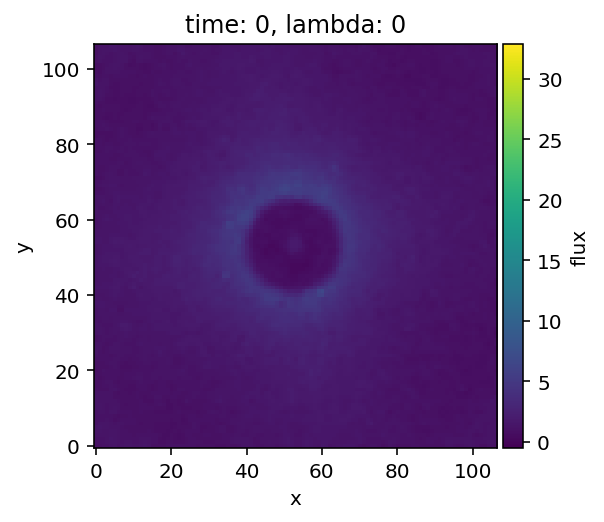

In [27]:
plot_cubes(cube_fc)

## 7.5. Post-processing of IFS data

Let's now try to recover the 2 injected companions using different post-processing algorithms.

### 7.5.1. Optimal scaling factors

In order to leverage the radial expansion of the stellar PSF with wavelength through spectral differential imaging, let's first compute the optimal scaling factors between the spectral channels. For a perfect AO correction, flat stellar spectrum and uniform atmospheric transmission, one would expect the scaling factors to be (exactly) inversely proportional to the wavelength. Although reality deviates a bit from these assumptions, these still make for a good first guess:

In [28]:
th_scal = lbda[-1]/lbda
th_scal

array([1.3877398, 1.375682 , 1.3635113, 1.3512615, 1.3389585, 1.3266245,
       1.3142908, 1.3019674, 1.2896852, 1.2774729, 1.2653329, 1.2532798,
       1.2413497, 1.2295421, 1.217879 , 1.2063586, 1.1950108, 1.1838219,
       1.1728301, 1.1620203, 1.151418 , 1.1410172, 1.1308315, 1.1208638,
       1.1111166, 1.1016016, 1.092311 , 1.0832641, 1.0744526, 1.0658859,
       1.0575558, 1.0494791, 1.0416555, 1.0340765, 1.0267497, 1.0196825,
       1.0128585, 1.0063006, 1.       ], dtype=float32)

Let's use `preproc.find_scal_vector` to refine this estimate. This function will find the optimal scaling factors (both in terms of geometric scaling and flux scaling) between each spectral channel and the last one such that their subtraction yields minimal residuals. For coronagraphic observations, it is recommended to provide a binary `mask`, corresponding to the location where the residuals will be calculated, which avoids the area encompassed by the coronagraphic mask, in order to achieve the best estimate.
Here we use the mean of the 4D cube along the temporal direction to find the factors:

In [29]:
from vip_hci.var import mask_circle
from vip_hci.preproc import find_scal_vector

mask = np.ones_like(cube[0,0])
mask = mask_circle(mask, int(0.16/plsc))

opt_scal_mean, opt_flux = find_scal_vector(np.mean(cube,axis=1), lbda, flux_st, 
                                           mask=mask, nfp=2, fm="stddev")

Although much slower, another approach would be to calculate the scaling factors for each individual spectral cube, and use the median values. To display the progress let's use a Progressbar:

In [30]:
from vip_hci.config import Progressbar 
opt_scals = np.zeros([cube.shape[1],cube.shape[0]])
opt_fluxes = np.zeros([cube.shape[1],cube.shape[0]])
for i in Progressbar(range(cube.shape[1]), verbose=True):
    opt_scals[i], opt_fluxes[i] = find_scal_vector(cube[:,i], lbda, flux_st, mask=mask, nfp=2, fm="stddev")

0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:09:53


In [31]:
opt_scal_med = np.median(opt_scals,axis=0)
opt_flux_med = np.median(opt_fluxes,axis=0)

Let's plot the theoretical and empirical scaling factors: 

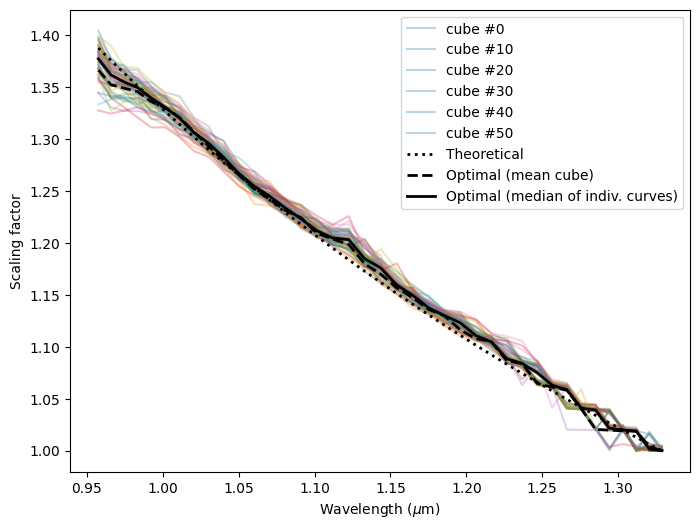

In [32]:
%matplotlib inline
plt.figure(figsize=(8,6))
for i in range(cube.shape[1]):
    if not i%10:
        label = 'cube #{}'.format(i)
    else:
        label = None
    plt.plot(lbda, opt_scals[i], alpha=0.3, label=label)
plt.plot(lbda, th_scal, 'k:', lw=2, label='Theoretical')
plt.plot(lbda, opt_scal_mean, 'k--', lw=2, label='Optimal (mean cube)')
plt.plot(lbda, np.median(opt_scals,axis=0), 'k-', lw=2, label='Optimal (median of indiv. curves)')
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("Scaling factor")
plt.legend()

Let's visualize the actual residuals in the first spectral cube (using the `frame_rescaling` routine to apply the optimal scaling factor):

In [33]:
from vip_hci.preproc import frame_rescaling
res_cube_test_opt = np.zeros([cube.shape[0],cube.shape[-2],cube.shape[-1]])
for i in range(cube.shape[0]):
    res_cube_test_opt[i] = opt_fluxes[0,i]*frame_rescaling(cube[i,0], scale=opt_scal_med[i])-cube[-1,0]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[107, 107, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
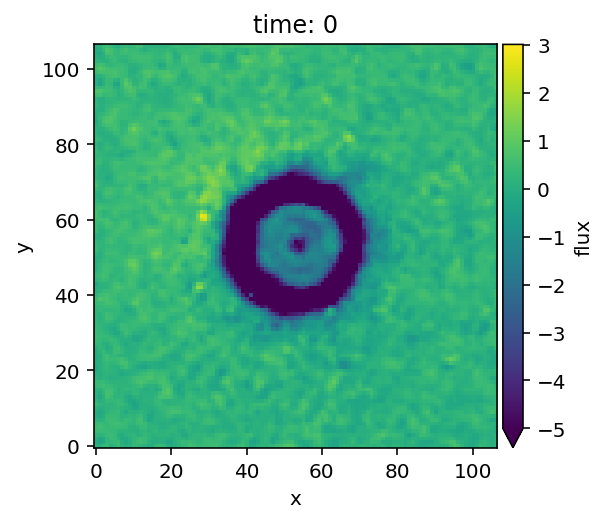

In [34]:
plot_cubes(res_cube_test_opt, vmin=-5)

Apart from the residual starlight at the edge of the coronagraphic mask (which does not expand radially), we see that the stellar halo is very well subtracted.

### 7.5.2. median-SDI 

The most basic way to leverage the radial diversity present in IFS data is to perform median-SDI (i.e. the radial equivalent to median-ADI). For that just use the `psfsub.median_sub` function, with the `sdi_only` option on: 

In [35]:
from vip_hci.psfsub import median_sub

mask_px = int(0.09/plsc)
med_SDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, sdi_only=True,
                     radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:40:39
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:17.345312
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:19.408581
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


For better results, it is recommended to use both the geometrical and flux scaling factors found in the previous section:

In [36]:
med_SDI_opt = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med, sdi_only=True,
                         radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:40:58
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:17.220773
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:19.133822
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's compare both reductions, showing circles at the ground truth locations where we injected the fake companions.

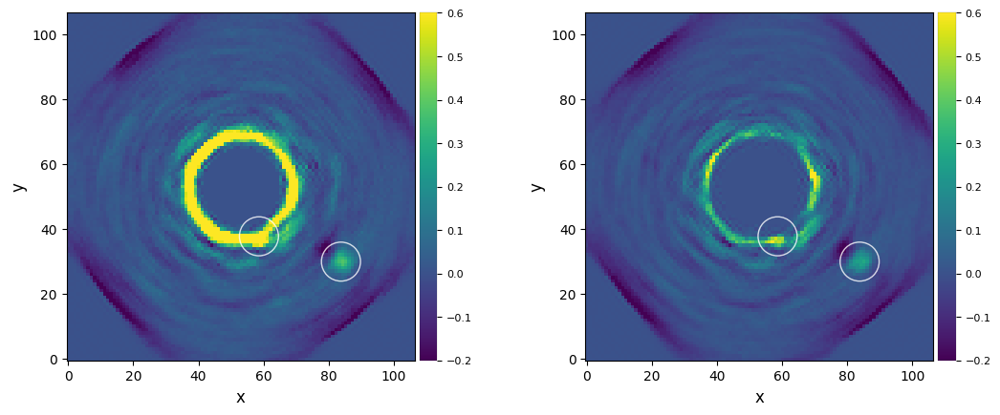

In [37]:
%matplotlib inline
plot_frames((med_SDI, med_SDI_opt), circle=(xy_b,xy_c), vmin=-0.2, vmax=0.6)

In the first image, we notice the limitation of SDI at short angular separation. Since the stellar residuals at the edge of the coronagraphic mask do not expand radially as the rest of the stellar halo, we are left with a bright spurious ring, preventing the re-detection of fake planet b.

We see that the median-SDI reduction with scaled fluxes performs slightly better at subtracting stellar residuals near the edge of the coronagraphic mask, although fake planet b is still not recovered.

Fake planet c is redetected. Let's compare its signal-to-noise ratio in both images:

In [38]:
from vip_hci.metrics import snr
snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_sc = snr(med_SDI_opt, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c, snr_c_sc)

19.81792937838819 23.22640649203268


Overall, we can conclude that the scaled flux version of median-SDI performs better than the non-flux scaled version.

### 7.5.3. PCA-SDI 

Let's now run a PCA-SDI reduction. Note that this approach may be useful in datasets with azimuthally extended disc features (since ADI can filter such signals). 

For PCA reductions, flux scaling factors are not necessary. This is because: i) the basis is orthonormal and an internal scaling is performed anyway when the principal components are projected onto each images; ii) flux scaling will typically increase the noise contribution before calculation of the principal components, which can bias their values. Our tests suggest indeed that better results are obtained (i.e. higher SNR for injected fake planets) when no flux scaling factor is considered before PCA.

#### 7.5.3.1. Full-frame PCA

To trigger SDI alone with the `psfsub.pca` function, you need to set: 

- `adimsdi='double'` to separate the PCA-SDI and PCA-ADI
- `ncomp` to a tuple of 2 values, the first of which being the number of principal components for PCA-SDI, and the second to be set to None - to prevent PCA-ADI (i.e. simply derotate and stack the SDI residual images);

Let's use the `mask_center_px` argument to set a numerical mask of 0.1'' radius in order not to include the coronagraphic mask.

Let's also set `imlib` and `interpolation` to non-default values for faster rescaling and (de-)rotations:

In [39]:
imlib = 'skimage'           # If you have it installed, feel free to set to 'opencv'
interpolation = 'biquintic'   # If you have opencv installed, feel free to set to 'lanczos4'

In [40]:
from vip_hci.psfsub import pca

ncomp_sdi = 1
mask_px = int(0.09/plsc)

pca_sdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=(ncomp_sdi,None), 
              adimsdi='double', crop_ifs=False, imlib=imlib, interpolation=interpolation, 
              interp_zeros=True, mask_val=0, mask_center_px=mask_px)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:41:18
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 3.290 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:00:15.340817
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
De-rotating and combining frames (skipping PCA)
Running time:  0:00:15.504656
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's show the final image with and without the application of a large (0.15'' radius) numerical mask, and with circles at the ground truth location where we injected the fake companions.

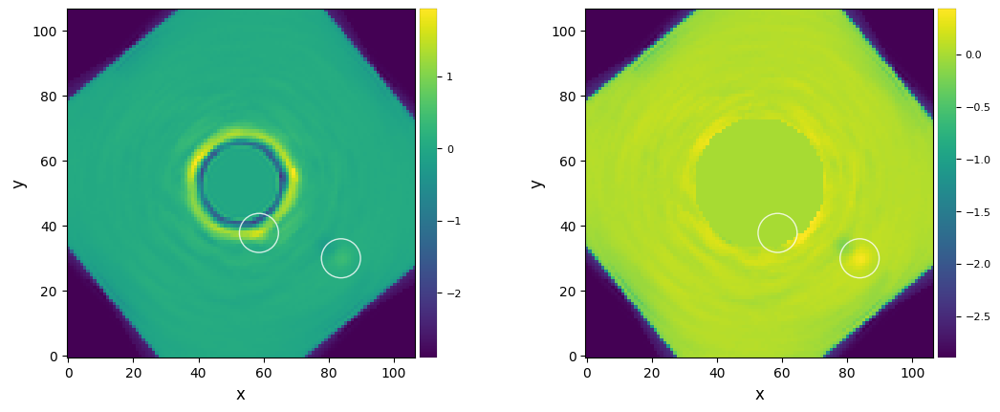

In [41]:
%matplotlib inline
plot_frames((pca_sdi, mask_circle(pca_sdi,20)),
            circle=(xy_b,xy_c))

In the first image, we notice the same effect as with median-SDI: significant stellar residuals at the edge of the coronagraphic mask.

On the other hand, fake planet c is easily re-detected. Notice the negative side lobe, that is reminiscent of ADI side lobes, but this time radially.

<font color=orange> **Question 7.1**: Why is the negative side lobe only radially inward of the planet in our final SDI image? </font>

This time the images obtained without and with flux-scaling applied to the cube before PCA appears to yield similar results. We note that flux scaling may actually have been slightly counter-productive, based on the raw fluxes at the location of the companion (peak value closer to ~0.4 without flux scaling, while closer to ~0.3 with flux scaling). Let's confirm that by measuring the SNR of c:

In [42]:
from vip_hci.metrics import snr
snr_c = snr(pca_sdi, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

12.781841904984528


#### 7.5.3.2. Annular PCA

PCA-SDI can also be performed in concentric annuli using `psfsub.pca_annular`. Again let's demonstrate whether flux scaling is useful or not:

In [43]:
from vip_hci.psfsub import pca_annular

ncomp_sdi = 1
mask_px = int(0.09/plsc)
fwhm_m = np.mean(fwhm)

pca_sdi_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, 
                          ncomp=(ncomp_sdi,None), radius_int=mask_px, fwhm=fwhm_m, asize=fwhm_m,
                          delta_sep=(0.3, 1), delta_rot=(0.5, 1),
                          mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:41:33
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:00:17.167127
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Skipping the second PCA subtraction


As before we show the image before and after masking the central part of the image, dominated by residual stellar light, to better show injected planet c:

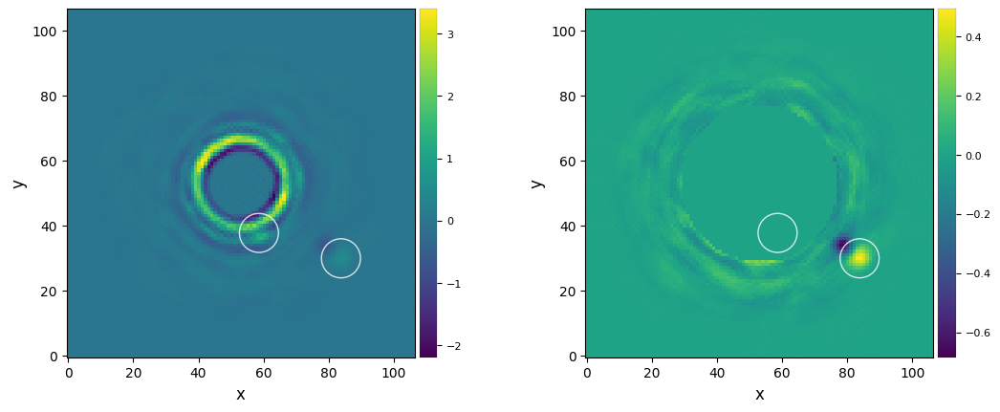

In [44]:
plot_frames((pca_sdi_ann, mask_circle(pca_sdi_ann, int(0.18/plsc))), circle=(xy_b,xy_c))

In [45]:
snr_c = snr(pca_sdi_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

16.555897988329143


Despite both reductions yielding relatively similar final images, we note that flux-scaling is slightly counter-productive (SNR slightly lower), similarly to the full-frame PCA reduction.

### 7.5.4. median-ASDI

Let's now combine both SDI and ADI, which should yield a better subtraction of the stellar residuals. Again, let's start with the most basic way to combine both strategies: median-ASDI. 

This simply involves the same calls to `median_sub` as in Sec. [7.5.2.](#7.5.2.-median-SDI), but removing `sdi_only=True`:

In [46]:
mask_px = int(0.09/plsc)

med_ASDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med,
                      radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:41:53
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:18.364268
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:20.449512
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's check the ASDI image:

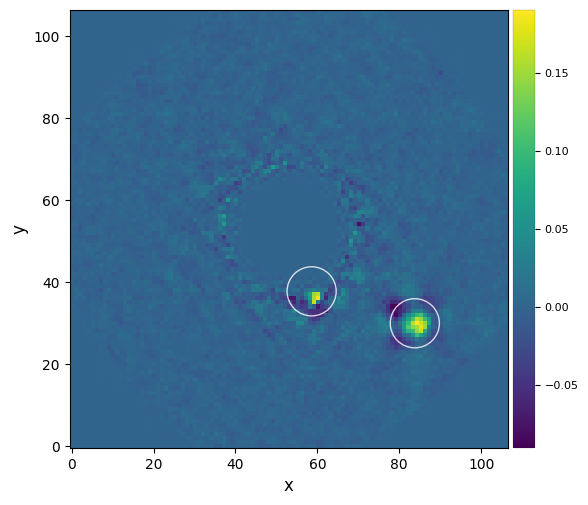

In [47]:
%matplotlib inline
plot_frames(med_ASDI, circle=(xy_b,xy_c))

This time we find signal at the location of fake planet b - although it does appear significantly filtered.

Fake planet c is easily redetected. Let's measure the signal-to-noise ratio for both fake planets:

In [48]:
snr_b = snr(med_SDI, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

0.9097275791820104
19.81792937838819


### 7.5.5. PCA-ASDI

#### 7.5.5.1. Full-frame PCA-ASDI (single step)

The ``psfsub.pca`` function in `VIP` offers the possibility to do this in either a single or 2 consecutive steps. 

In the first case, a master PCA library is created with all images acquired at different parallactic angles and at different wavelengths (i.e. containing both angular and radial diversity). This is done by setting:

- `adimsdi='single'` (default);
- `ncomp` to either a scalar value (integer to use that number of principal components, or float between 0 and 1 to indicate the desired cumulative explained variance ratio), or a list (of integer values to be tested).

Let's try with a list of a few ncomp values:

In [49]:
ncomp = [1,5,10,20]
pca_asdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
               adimsdi='single', crop_ifs=False, mask_center_px=mask_px,
               imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:42:13
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 3.224 GB
Rescaling the spectral channels to align the speckles
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:07
Running time:  0:00:07.898087
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
2145 total frames
Performing single-pass PCA
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:28.111506
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Computed residual frames for PCs interval: [1, 5, 10

Let's visualize the resulting image, including circles at the ground truth locations of the injected planets:

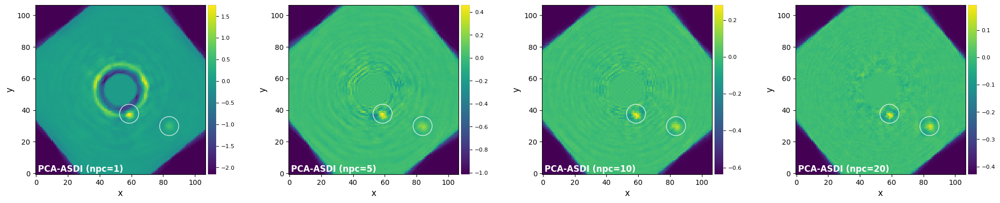

In [50]:
labels = tuple(['PCA-ASDI (npc={:.0f})'.format(npc) for npc in ncomp])
plot_frames(pca_asdi, label=labels,
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [51]:
snr_b = [snr(pca_asdi[i], xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True) for i in range(len(ncomp))]
print(snr_b)

snr_c = [snr(pca_asdi[i], xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True) for i in range(len(ncomp))]
print(snr_c)

[1.6473287851234246, 5.174644502161828, 9.193702125591468, 5.456633290533542]
[11.09562890427494, 22.160314653515435, 30.91657020627059, 32.0115277132438]


#### 7.5.5.2. Full-frame PCA-ASDI (double step)

The second option consists in performing PCA-SDI first, and then PCA-ADI on the cube consisting of residual SDI frames obtained for each individual spectral cube. This mode can be activated by setting `adimsdi='double'` (instead of the default 'single' value).

Given the high correlation in the spectral dimension, let's just try with 1pc for each step:

In [52]:
ncomp = (1,1)
pca_asdi_2s = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                  adimsdi='double', crop_ifs=False, mask_center_px=mask_px,
                  interp_zeros=True, mask_val=0,
                  imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:43:14
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 4.711 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:00:15.814789
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA stage exploiting rotational variability
De-rotating and combining residuals
Running time:  0:00:16.004056
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


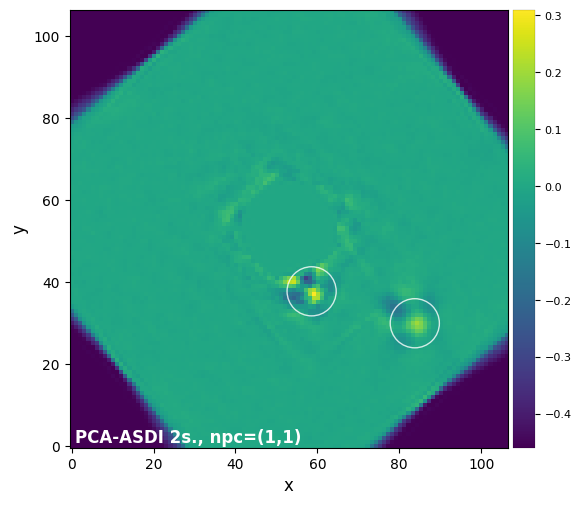

In [53]:
plot_frames(pca_asdi_2s,
            label='PCA-ASDI 2s., npc=({:.0f},{})'.format(ncomp[0],ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [54]:
snr_b = snr(pca_asdi_2s, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_asdi_2s, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

4.917762300669619
51.4835450246924


We see that with only 1 spectral PC followed by 1 angular PC, parts of the final images can be much cleaner of residual starlight, as also testified by the SNR~50 for injected planet c.

#### 7.5.5.3. Annular PCA-ASDI (double step) 

Similarly, ASDI can be done in concentric annuli with the `pca_annular` function:

In [55]:
ncomp = (1,1)
pca_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                      radius_int=mask_px, fwhm=np.mean(fwhm), asize=np.mean(fwhm), 
                      mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:43:30
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:00:19.117560
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA subtraction exploiting angular variability
N annuli = 6, FWHM = 6.000
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  2.29    Ann center:  15    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:19.162806
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  4.57    Ann center:  21    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:19.194432
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 

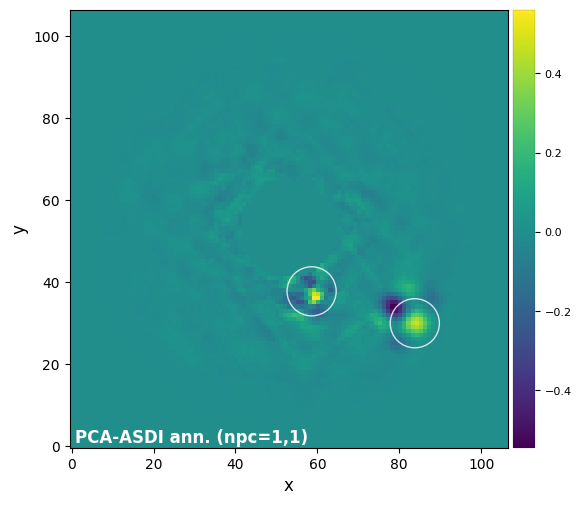

In [56]:
plot_frames(pca_ann, label='PCA-ASDI ann. (npc={:.0f},{:.0f})'.format(ncomp[0], ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [57]:
snr_b = snr(pca_ann, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

10.256502247434709
38.183397286765874


In [58]:
from vip_hci.metrics import significance

sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

At a separation of 16.3 px (2.7 FWHM), S/N = 10.3 corresponds to a 5.5-sigma detection in terms of Gaussian false alarm probability.
5.507620264057997
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


### 7.5.6. PCA-ADI for all spectral channels

If you provide a 4d input cube without `scale_list` to the `pca` or `pca_annular` functions, their default behaviour will be to perform PCA-ADI on each spectral channel and then combine the final ADI images from each spectral channel into a single one. 

In [59]:
mask_px = int(0.08/plsc)

Let's try different flavours of PCA. First let's run it in full frames:

In [60]:
ncomp_ff = 6
pca_adi_mean = pca(cube_fc, derot_angles, ncomp=ncomp_ff, mask_center_px=mask_px,
                   interp_zeros=True, mask_val=0, imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:43:52
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 3.870 GB
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.028750
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:00.203303
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.227674
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:00.397865
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55

Now in concentric annuli, with a PA threshold (set by `delta_rot`):

In [61]:
ncomp_ann = 4
pca_adi_ann_mean = pca_annular(cube_fc, derot_angles, ncomp=ncomp_ann, radius_int=mask_px, 
                               fwhm=np.mean(fwhm), asize=2*np.mean(fwhm), delta_rot=(0.2,1),
                               mask_val=0, interp_zeros=True, imlib=imlib, interpolation=interpolation)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:43:59
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.062115
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.112310
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with lapack for current annulus
Running time:  0:00:00.163639
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:00:00.332096
――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:25.052289
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:02:27.416946
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.011655
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.470096
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.911330
―――――――――――――――――――――――――――――――――――――――――――――

Finally, let's also run it as a single wide annulus including both injected planets:

In [62]:
from vip_hci.psfsub import pca_annulus
ncomp_a = 3
pca_adi_a_mean = pca_annulus(cube_fc, derot_angles, ncomp=ncomp_a, r_guess=(r_b+r_c)/2, 
                             annulus_width=r_c, mask_val=0, interp_zeros=True,
                             imlib=imlib, interpolation=interpolation)

Let's compare the results:

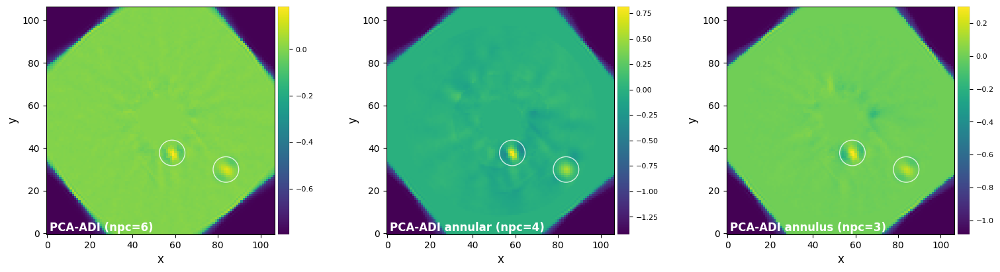

In [63]:
plot_frames((pca_adi_mean, pca_adi_ann_mean, pca_adi_a_mean),
            label=('PCA-ADI (npc={:.0f})'.format(ncomp_ff),
                   'PCA-ADI annular (npc={:.0f})'.format(ncomp_ann),
                   'PCA-ADI annulus (npc={:.0f})'.format(ncomp_a)),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [64]:
snr_b_ff = snr(pca_adi_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_ann = snr(pca_adi_ann_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_a = snr(pca_adi_a_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b_ff, snr_b_ann, snr_b_a)
snr_b = max(snr_b_ff, snr_b_ann, snr_b_a)

snr_c_ff = snr(pca_adi_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_ann = snr(pca_adi_ann_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_a = snr(pca_adi_a_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c_ff, snr_c_ann, snr_c_a)
snr_c = max(snr_c_ff, snr_c_ann, snr_c_a)

9.964575355731181 6.194275666961779 4.668026246564868
31.688689438349595 11.400841177824212 24.621333311752664


In [65]:
sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

At a separation of 16.3 px (2.7 FWHM), S/N = 10.0 corresponds to a 5.4-sigma detection in terms of Gaussian false alarm probability.
5.440259378094337
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


In this case, we see that ADI alone recovers better the innermost planet. This is because of the bright stellar residuals at the edge of the coronagraphic mask, preventing SDI to do a good job at that separation.

<font color=green> **Answer 7.1**: The scaling factors are such that all spectral channels are upscaled, for the stellar halo to match the last spectral channel, i.e. all factors are >= 1 (exactly 1 for the last spectral channel). The PSF model and subtraction with PCA is then made with these upscaled images, where the planet is now present at different radial separations. However since we injected a very red spectrum for planet c (blackbody of 1100 K), it is the brightest in the last spectral channels. This means the strongest positive (resp. negative) imprint will be in the long (resp. short) wavelength channels, where the planet was not moved (resp. moved radially outward), i.e. the positive (resp. negative) imprint is unchanged (resp. radially inward) with respect to its position in the upscaled cube. After final downscaling, the negative imprint stays thus radially inward from the location of the fake planet. 
You can test this explanation by injecting a blue spectrum for planet c (e.g. 1/blackbody). </font>

## 7.6. Astrometry retrieval

The `firstguess` function can accept a 4D input cube to infer a first guess on the position (a single one for all channels) and fluxes (one per channel). Since it would be very slow to run it on all 39 spectral channels, let's just focus on the 8 channels (~20% of all channels) with the maximum S/N ratio. Let's find these channels for planet c. 

As the rest of this tutorial is CPU-intensive, **we will only focus on planet c** - although the same procedure can be applied to planet b.

### 7.6.1. Spectral channels with maximum SNR

**Channel 1**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:19
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012564
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=1.406
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.223
Central pixel S/N = 1.169
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 1.403
Max S/N (shifting the aperture center) = 2.257
stddev S/N (shifting the aperture center) = 0.568

Opt SNR: 1.406315822640483, for npc=1
**Channel 2**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.560
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.131
Central pixel S/N = 4.489
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.574
Max S/N (shifting the aperture center) = 4.695
stddev S/N (shifting the aperture center) = 0.771

Opt SNR: 3.560228545229816, for npc=1
**Channel 3**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:23
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012508
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.363
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.365
Central pixel S/N = 3.768
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.360
Max S/N (shifting the aperture center) = 4.876
stddev S/N (shifting the aperture center) = 0.682

Opt SNR: 3.3626991555800974, for npc=1
**Channel 4**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:25
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011827
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.550
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.724
Central pixel S/N = 4.389
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.563
Max S/N (shifting the aperture center) = 4.322
stddev S/N (shifting the aperture center) = 0.507

Opt SNR: 3.550228902599102, for npc=1
**Channel 5**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011690
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.470
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.982
Central pixel S/N = 4.377
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.471
Max S/N (shifting the aperture center) = 4.256
stddev S/N (shifting the aperture center) = 0.499

Opt SNR: 3.4698553173521773, for npc=1
**Channel 6**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:30
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012223
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.916
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.235
Central pixel S/N = 4.827
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.908
Max S/N (shifting the aperture center) = 4.797
stddev S/N (shifting the aperture center) = 0.590

Opt SNR: 3.9162354555822882, for npc=1
**Channel 7**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:32
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012341
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.614
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.048
Central pixel S/N = 4.412
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.581
Max S/N (shifting the aperture center) = 4.569
stddev S/N (shifting the aperture center) = 0.571

Opt SNR: 3.6135618037373716, for npc=1
**Channel 8**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:34
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011346
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.132
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.449
Central pixel S/N = 5.372
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.137
Max S/N (shifting the aperture center) = 5.290
stddev S/N (shifting the aperture center) = 0.670

Opt SNR: 4.131686920746008, for npc=1
**Channel 9**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:36
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011836
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.444
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.665
Central pixel S/N = 5.831
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.430
Max S/N (shifting the aperture center) = 5.878
stddev S/N (shifting the aperture center) = 0.874

Opt SNR: 4.443944112734254, for npc=1
**Channel 10**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:38
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011299
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.104
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.562
Central pixel S/N = 5.136
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.033
Max S/N (shifting the aperture center) = 5.448
stddev S/N (shifting the aperture center) = 0.842

Opt SNR: 4.104050624135878, for npc=1
**Channel 11**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:40
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011955
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.275
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.083
Central pixel S/N = 5.335
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.247
Max S/N (shifting the aperture center) = 5.563
stddev S/N (shifting the aperture center) = 0.938

Opt SNR: 4.274623331158116, for npc=1
**Channel 12**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:43
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011829
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=4.568
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.937
Central pixel S/N = 6.006
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.385
Max S/N (shifting the aperture center) = 6.781
stddev S/N (shifting the aperture center) = 1.192

Opt SNR: 4.567621084931069, for npc=5
**Channel 13**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011936
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=5.285
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.977
Central pixel S/N = 6.535
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.804
Max S/N (shifting the aperture center) = 7.018
stddev S/N (shifting the aperture center) = 1.416

Opt SNR: 5.285349465825721, for npc=5
**Channel 14**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:47
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011793
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=6.249
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.265
Central pixel S/N = 7.268
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.373
Max S/N (shifting the aperture center) = 7.461
stddev S/N (shifting the aperture center) = 1.470

Opt SNR: 6.248796814948493, for npc=4
**Channel 15**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:49
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011034
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 6, for S/N=6.068
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.061
Central pixel S/N = 7.042
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.016
Max S/N (shifting the aperture center) = 7.526
stddev S/N (shifting the aperture center) = 1.624

Opt SNR: 6.068032431052506, for npc=6
**Channel 16**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:51
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.010943
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 7, for S/N=7.357
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.238
Central pixel S/N = 8.839
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.367
Max S/N (shifting the aperture center) = 9.763
stddev S/N (shifting the aperture center) = 2.016

Opt SNR: 7.357126409737286, for npc=7
**Channel 17**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:53
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011678
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=5.498
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.937
Central pixel S/N = 6.952
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.478
Max S/N (shifting the aperture center) = 8.157
stddev S/N (shifting the aperture center) = 1.455

Opt SNR: 5.497769065327149, for npc=1
**Channel 18**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:55
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011750
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.958
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.309
Central pixel S/N = 5.803
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.023
Max S/N (shifting the aperture center) = 7.694
stddev S/N (shifting the aperture center) = 1.342

Opt SNR: 4.958351756255778, for npc=1
**Channel 19**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:57
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011421
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.867
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.237
Central pixel S/N = 6.065
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.887
Max S/N (shifting the aperture center) = 7.327
stddev S/N (shifting the aperture center) = 1.337

Opt SNR: 4.8671778914611314, for npc=1
**Channel 20**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:44:59
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011646
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=6.235
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.397
Central pixel S/N = 7.616
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.559
Max S/N (shifting the aperture center) = 8.355
stddev S/N (shifting the aperture center) = 1.775

Opt SNR: 6.235377957943322, for npc=3
**Channel 21**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:02
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012479
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=7.010
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.939
Central pixel S/N = 8.242
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.619
Max S/N (shifting the aperture center) = 9.557
stddev S/N (shifting the aperture center) = 1.671

Opt SNR: 7.009732024726299, for npc=3
**Channel 22**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:04
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011781
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/Users/valentin/GitHub/VIP/vip_hci/psfsub/utils_pca.py:381: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=vip_figsize, dpi=vip_figdpi)
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=8.449
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.581
Central pixel S/N = 9.729
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 7.798
Max S/N (shifting the aperture center) = 12.240
stddev S/N (shifting the aperture center) = 2.354

Opt SNR: 8.449449009570616, for npc=3
**Channel 23**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:06
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011800
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=10.653
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.166
Central pixel S/N = 12.208
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.903
Max S/N (shifting the aperture center) = 12.388
stddev S/N (shifting the aperture center) = 2.410

Opt SNR: 10.652709378844564, for npc=4
**Channel 24**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:08
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011317
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=10.948
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.436
Central pixel S/N = 12.679
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.807
Max S/N (shifting the aperture center) = 12.635
stddev S/N (shifting the aperture center) = 2.461

Opt SNR: 10.948329926561087, for npc=4
**Channel 25**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:10
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011547
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=13.553
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.981
Central pixel S/N = 13.963
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.520
Max S/N (shifting the aperture center) = 14.787
stddev S/N (shifting the aperture center) = 2.766

Opt SNR: 13.553054584302888, for npc=4
**Channel 26**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:12
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.015208
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=11.518
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.691
Central pixel S/N = 13.452
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.950
Max S/N (shifting the aperture center) = 14.002
stddev S/N (shifting the aperture center) = 3.179

Opt SNR: 11.5179708785798, for npc=5
**Channel 27**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:15
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011635
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=12.303
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.905
Central pixel S/N = 14.044
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 9.448
Max S/N (shifting the aperture center) = 14.375
stddev S/N (shifting the aperture center) = 3.292

Opt SNR: 12.302576009150227, for npc=5
**Channel 28**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.014834
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=14.285
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.259
Central pixel S/N = 14.322
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.231
Max S/N (shifting the aperture center) = 16.153
stddev S/N (shifting the aperture center) = 3.339

Opt SNR: 14.2852448151926, for npc=5
**Channel 29**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:19
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011709
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=16.080
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.390
Central pixel S/N = 13.661
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.084
Max S/N (shifting the aperture center) = 14.893
stddev S/N (shifting the aperture center) = 3.317

Opt SNR: 16.080014328608577, for npc=5
**Channel 30**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:21
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012095
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=17.060
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.735
Central pixel S/N = 13.771
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.397
Max S/N (shifting the aperture center) = 15.881
stddev S/N (shifting the aperture center) = 3.451

Opt SNR: 17.059942544708445, for npc=5
**Channel 31**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:23
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012268
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=18.046
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.651
Central pixel S/N = 13.531
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.727
Max S/N (shifting the aperture center) = 16.195
stddev S/N (shifting the aperture center) = 3.772

Opt SNR: 18.045760468153613, for npc=5
**Channel 32**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:25
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011810
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=17.494
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 4.455
Central pixel S/N = 17.641
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.917
Max S/N (shifting the aperture center) = 18.422
stddev S/N (shifting the aperture center) = 3.596

Opt SNR: 17.494045453004787, for npc=4
**Channel 33**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:27
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011798
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=18.575
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.238
Central pixel S/N = 18.353
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 12.649
Max S/N (shifting the aperture center) = 18.763
stddev S/N (shifting the aperture center) = 3.816

Opt SNR: 18.57466350557792, for npc=3
**Channel 34**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:29
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011656
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=19.378
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.632
Central pixel S/N = 16.965
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.769
Max S/N (shifting the aperture center) = 18.142
stddev S/N (shifting the aperture center) = 3.565

Opt SNR: 19.37834079637245, for npc=3
**Channel 35**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:32
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011720
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=21.623
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 5.144
Central pixel S/N = 18.531
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 13.619
Max S/N (shifting the aperture center) = 22.455
stddev S/N (shifting the aperture center) = 4.724

Opt SNR: 21.6226239255198, for npc=4
**Channel 36**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:34
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012530
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=20.234
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.507
Central pixel S/N = 16.550
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.979
Max S/N (shifting the aperture center) = 18.420
stddev S/N (shifting the aperture center) = 3.866

Opt SNR: 20.234224573895204, for npc=3
**Channel 37**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:36
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.012314
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=19.646
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 16.880
Central pixel S/N = 21.843
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 16.372
Max S/N (shifting the aperture center) = 22.743
stddev S/N (shifting the aperture center) = 4.135

Opt SNR: 19.646382108154057, for npc=1
**Channel 38**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:38
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011906
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=20.957
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 15.671
Central pixel S/N = 24.066
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 17.039
Max S/N (shifting the aperture center) = 24.544
stddev S/N (shifting the aperture center) = 4.638

Opt SNR: 20.957140197893363, for npc=1
**Channel 39**
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:40
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.011859
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 2, for S/N=23.472
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.541
Central pixel S/N = 14.163
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 14.472
Max S/N (shifting the aperture center) = 19.366
stddev S/N (shifting the aperture center) = 3.306

Opt SNR: 23.47182015357593, for npc=2


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:17: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_56271/3656633532.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


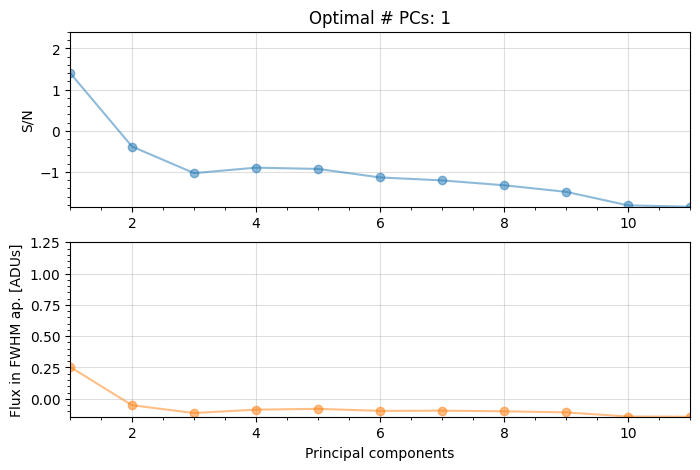

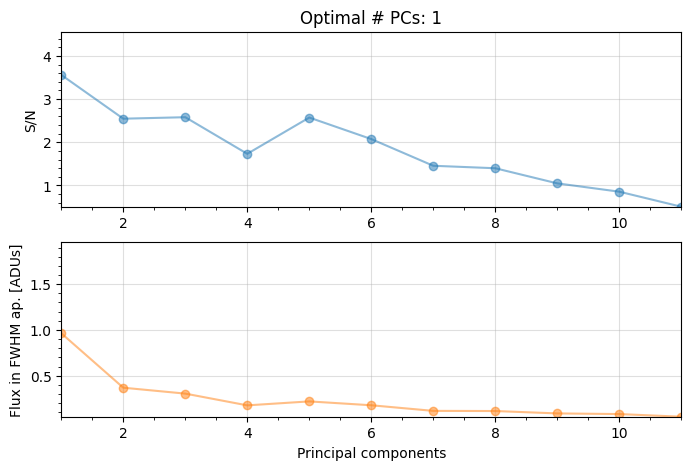

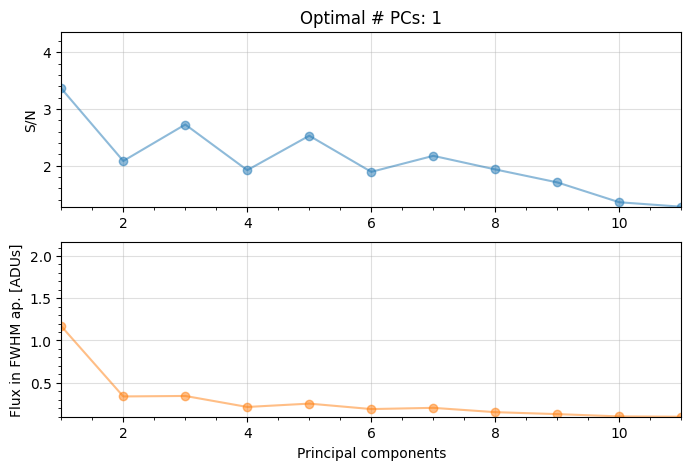

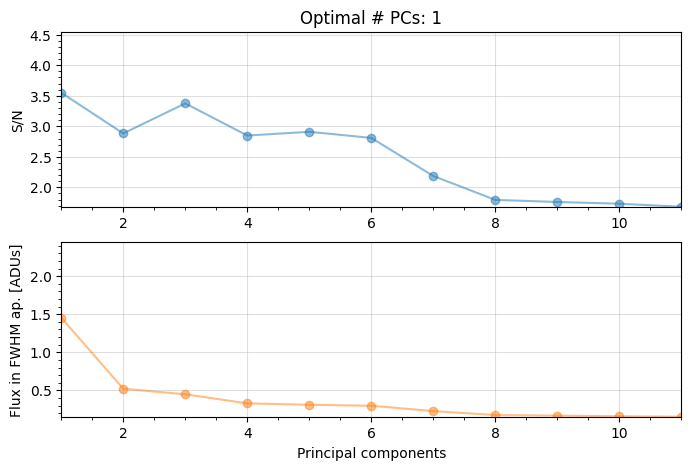

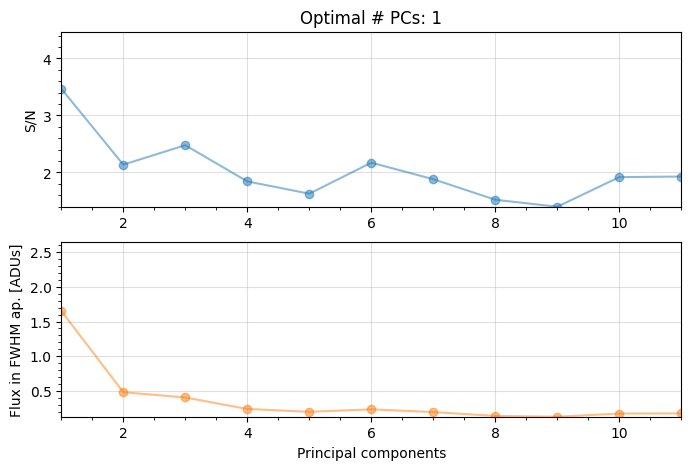

...

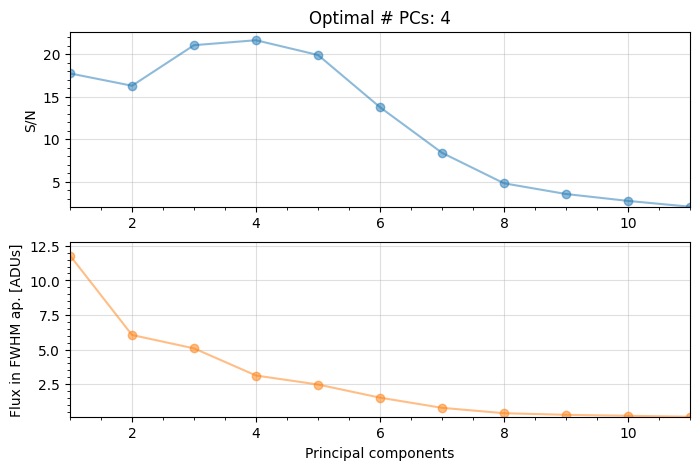

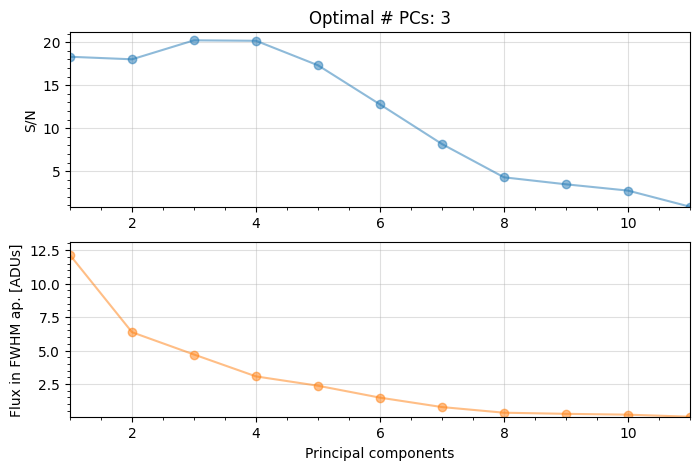

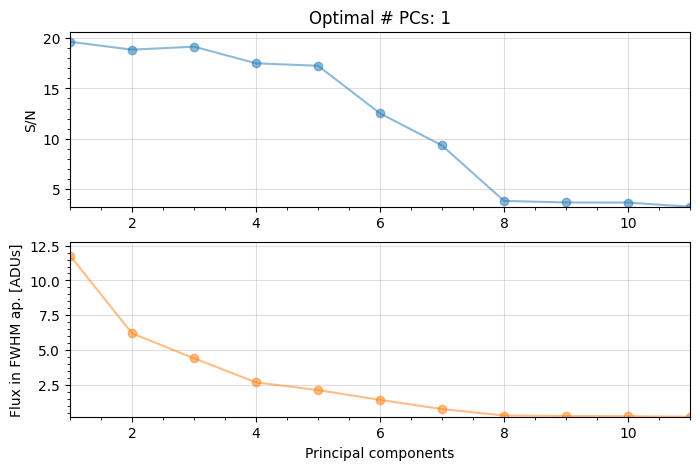

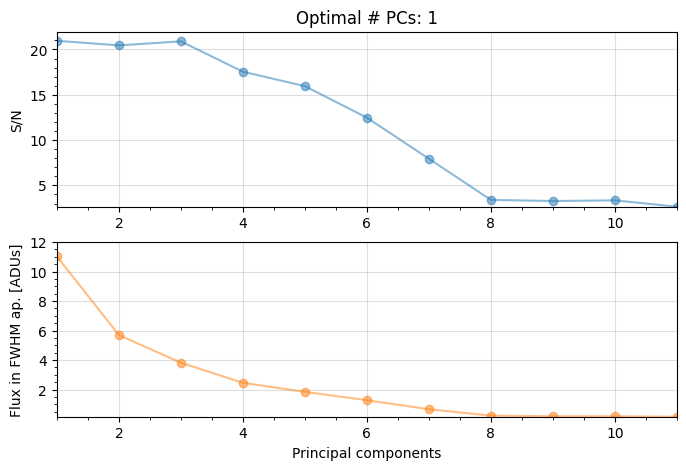

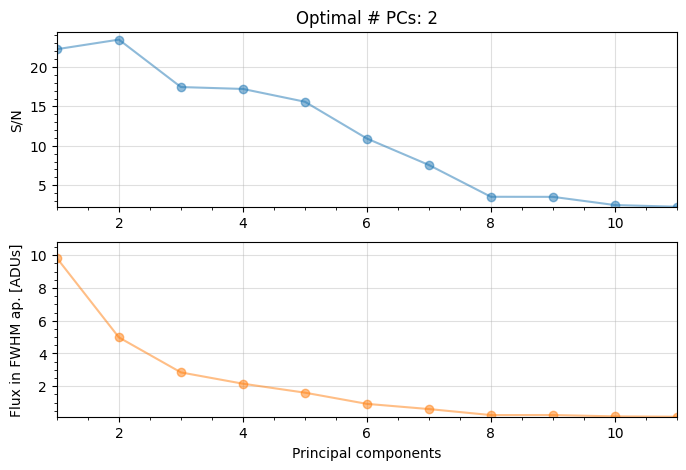

In [66]:
from vip_hci.psfsub import pca_grid

all_frs = []
all_snrs = []
all_pcs = []
for i in range(nch):
    print("**Channel {}**".format(i+1))
    res_ann_opt = pca_grid(cube_fc[i], derot_angles, fwhm=fwhm[i], range_pcs=(1,11,1), 
                           source_xy=xy_c, mode='annular', annulus_width=int(4*fwhm[i]), 
                           imlib=imlib, interpolation=interpolation, full_output=True,
                           plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, df, opt_npc_ann = res_ann_opt
    all_frs.append(final_ann_opt)
    pcs = df['PCs']
    snrs = df['S/Ns']
    opt_snr = snrs[df.index[pcs==opt_npc_ann]]
    print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
    all_snrs.append(float(opt_snr))
    all_pcs.append(opt_npc_ann)

Let's plot the results:

Text(0, 0.5, 'SNR of c')

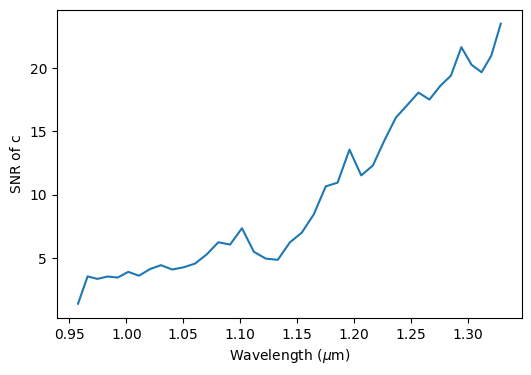

In [67]:
plt.figure(figsize=(6,4))
plt.plot(lbda, all_snrs)
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("SNR of c")

Let's (reverse) sort to only keep the best 8 channels:

In [68]:
order_snr = np.flip(np.argsort(all_snrs))
sorted_npc = np.array(all_pcs)[order_snr]
sorted_ch = np.arange(nch)[order_snr]
sorted_frs = np.array(all_frs)[order_snr]
sorted_snr = np.array(all_snrs)[order_snr]

Let's finally show these 8 channels with optimal SNR:

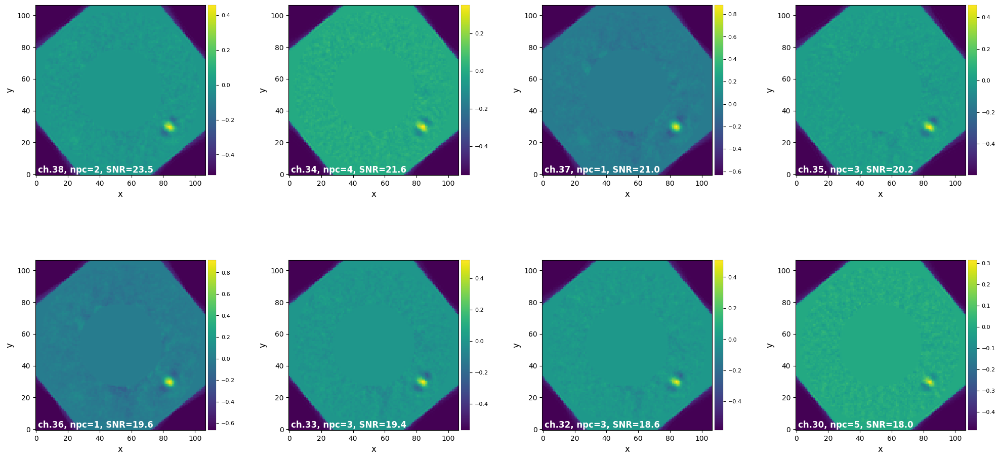

In [69]:
cutoff = 8
final_frs_c = tuple(sorted_frs[:cutoff])
final_chs_c = sorted_ch[:cutoff]
final_npcs_c = sorted_npc[:cutoff]

labels = ['ch.{}, npc={}, SNR={:.1f}'.format(final_chs_c[i], final_npcs_c[i], sorted_snr[i]) for i in range(cutoff)]
labels = tuple(labels)

plot_frames(final_frs_c, label=labels, rows=2)

### 7.6.2. NEGFC+PCA-ADI (simplex)

Let's now find the optimal position of planet c by running the `firstguess` function on the 8 best spectral channels (corresponding to the highest SNR, as determined above):

In [70]:
crop_cube_c = cube_fc[final_chs_c]
crop_cube_c.shape

(8, 55, 107, 107)

In [71]:
psfn_crop_c = psfn[final_chs_c]

In [72]:
trans_crop_c = [trans[0]]
for i in final_chs_c:
    trans_crop_c.append(trans[i])
trans_crop_c = np.array(trans_crop_c)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 14:45:48
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.8,29.9], running ...
Processing spectral channel 0...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 1...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.5)
Processing spectral channel 2...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 3...
... optimal grid flux: 38.566 ($\chi^2_r$ = 1.4)
Processing spectral channel 4...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 5...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 6...
... optimal gr

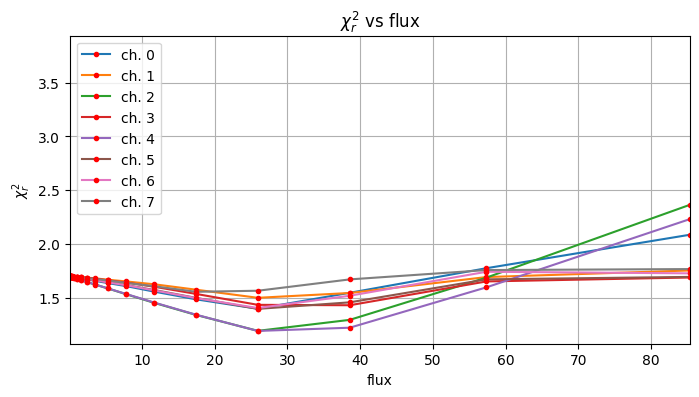

Planet 0: preliminary position guess: (r, theta)=(38.5, 323.1)
Planet 0: preliminary flux guess: 25.9, 25.9, 25.9, 38.6, 25.9, 25.9, 25.9, 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 599, nfev: 981, chi2r: 0.08273690102140464
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f0, f1, f2, f3, f4, f5, f6, f7)=(25.818, 30.198, 29.524, 32.601, 31.230, 29.441, 27.446, 20.260) at 
          (X,Y)=(83.76, 29.96)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  1:11:19.599622
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


In [73]:
from vip_hci.fm import firstguess
res = firstguess(crop_cube_c, derot_angles, psfn_crop_c, ncomp=list(final_npcs_c),
                 planets_xy_coord=[xy_c], fwhm=np.mean(fwhm), annulus_width=int(4*np.mean(fwhm)),
                 aperture_radius=2, imlib=imlib, interpolation=interpolation, transmission=trans_crop_c, mu_sigma=True, 
                 force_rPA=False, simplex=True, plot=True, verbose=True)
r0c = res[0]
theta0c = res[1]
fluxes0c = res[2]

In [74]:
res

(array([38.43053665]),
 array([323.17227216]),
 array([[25.81842079, 30.19799045, 29.52422292, 32.60082118, 31.23004471,
         29.44067354, 27.44591763, 20.25968548]]))

Let's compare the estimates to their respective ground truth values:

In [75]:
print("r (gt): {:.2f} VS. r (estimated): {:.2f}".format(r_c, r0c[0]))
print("theta (gt): {:.2f} VS. r (estimated): {:.2f}".format(theta_c%360, theta0c[0]))
for i, ch in enumerate(final_chs_c):
    print("flux ch.{} (gt): {:.2f} VS. r (estimated): {:.2f}".format(ch, flux_c_scal[ch], fluxes0c[0,i]))

r (gt): 38.50 VS. r (estimated): 38.43
theta (gt): 323.13 VS. r (estimated): 323.17
flux ch.38 (gt): 24.66 VS. r (estimated): 25.82
flux ch.34 (gt): 29.42 VS. r (estimated): 30.20
flux ch.37 (gt): 28.25 VS. r (estimated): 29.52
flux ch.35 (gt): 30.51 VS. r (estimated): 32.60
flux ch.36 (gt): 30.09 VS. r (estimated): 31.23
flux ch.33 (gt): 27.34 VS. r (estimated): 29.44
flux ch.32 (gt): 25.13 VS. r (estimated): 27.45
flux ch.30 (gt): 22.10 VS. r (estimated): 20.26


### 7.6.3. NEGFC+PCA-ADI (MCMC)

A better, albeit slower way, to infer the astrometry of each planet with uncertainties is to use an MCMC approach. Our specific case can be solved with the `mcmc_negfc_sampling`, which can, since VIP v1.2.3, also deal with 4D cubes. We refer to [Tutorial 5A](https://vip.readthedocs.io/en/latest/tutorials/05_fm_planets.html#5.3.3.-NEGFC-technique-coupled-with-MCMC) for more details on how to set up the parameters for the MCMC algorithm.

In [76]:
import pickle

lab='c'
ann_width = 4*np.mean(fwhm)
aperture_radius=2
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': 2}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

<div class="alert alert-block alert-info"> 
    <b>Note: </b>
<a class="anchor" id="note1"></a>

When the flux variation is known throughout the observation (e.g. through a background star or satellite spots) or if you wish to take into account the effect of airmass, it is possible to provide a `weights` parameter for the injection of the mean flux to be scaled at the moment of injection in each image to follow in (this is a new addition since [Christiaens et al. 2021](https://ui.adsabs.harvard.edu/abs/2021MNRAS.502.6117C/abstract)).
</div>

In [77]:
weights=X_fac

In [78]:
# input to MCMC
init = [r0c[0], theta0c[0]]
for i in range(cutoff):
    init.append(fluxes0c[0,i])
initial_state = np.array(init)
obs_params['psfn']= psfn[final_chs_c]
obs_params['fwhm']= np.mean(fwhm[final_chs_c])
obs_params['transmission']= trans_crop_c
algo_params['ncomp'] = list(final_npcs_c)

<div class="alert alert-block alert-warning"> 
    <b>Warning: </b>
<a class="anchor" id="note1"></a>

The following box is very computer intensive. It can be skipped if needed (results loaded in the subsequent one).
</div>

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-08 15:57:08
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean and stddev in the annulus at the radius of the companion (excluding the PA area directly adjacent to it) are -0.00 and 0.08 respectively.
Beginning emcee Ensemble sampler...
emcee Ensemble sampler successful

Start of the MCMC run ...
Step  |  Duration/step (sec)  |  Remaining Estimated Time (sec)
0		81.68936			40762.99264
1		83.24805			41457.52940
2		83.43421			41466.80088
3		87.95120			43623.79371
4		87.83650			43479.06898
5		83.79669			41395.56437
6		84.11321			41467.81154
7		85.93990			42282.43031
8		84.86983			41671.08555
9		83.30998			40821.89069
10		83.31553			40741.29319
11		84.16042			41070.28252
12		83.27096			40552.95606
13		83.74174			40698.

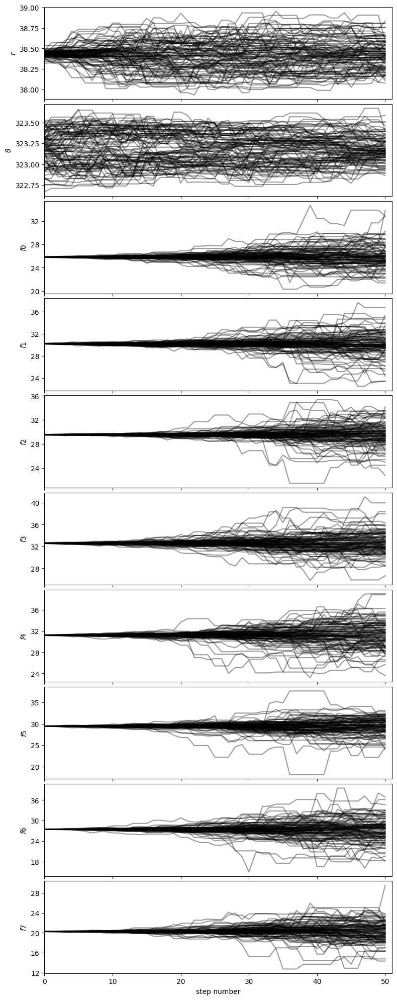

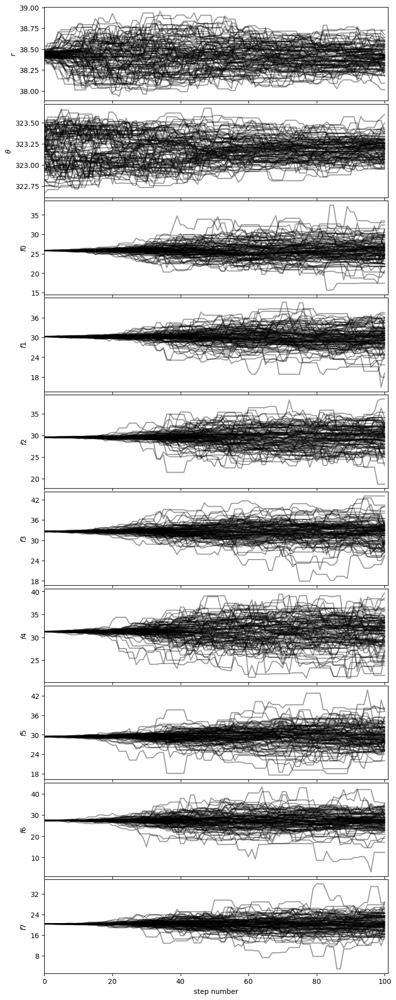

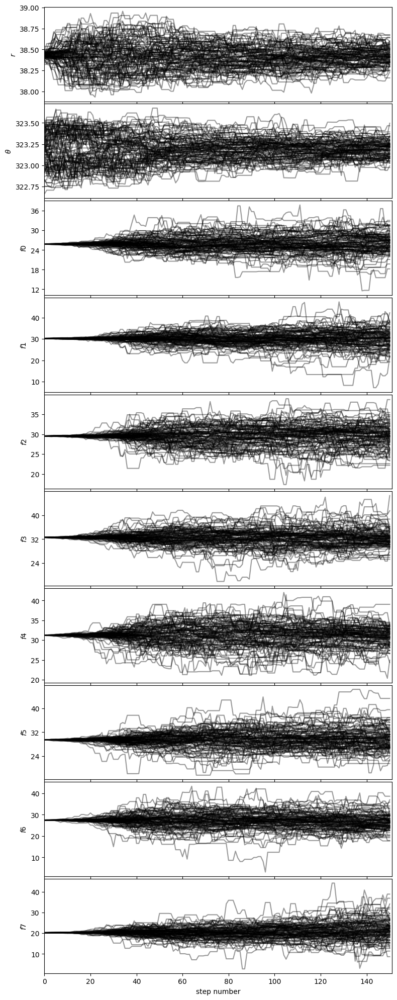

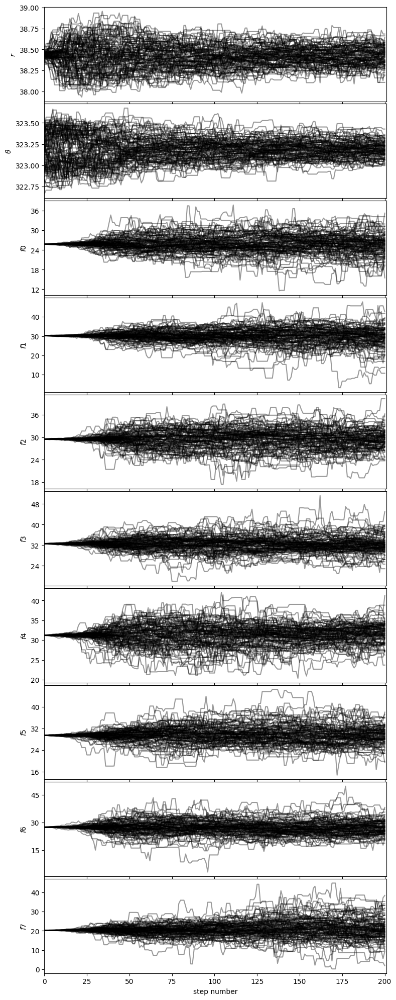

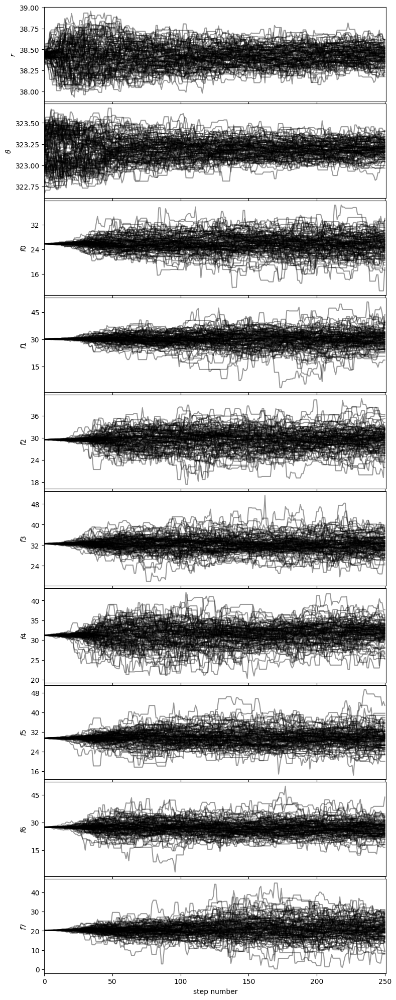

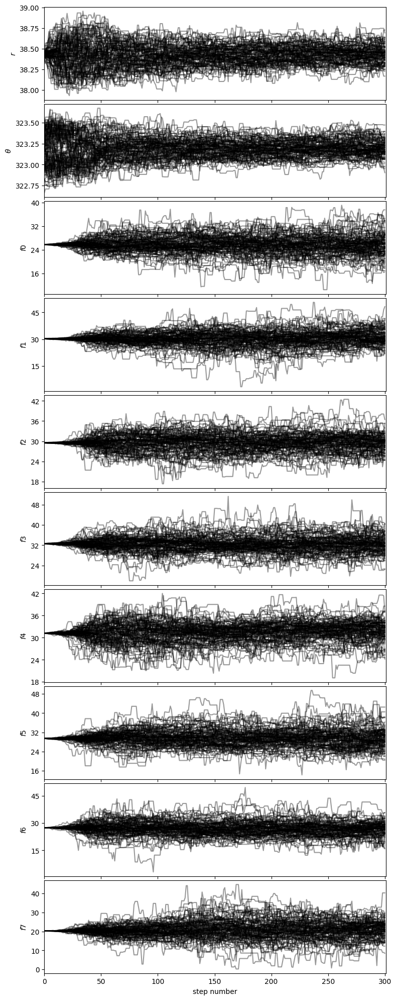

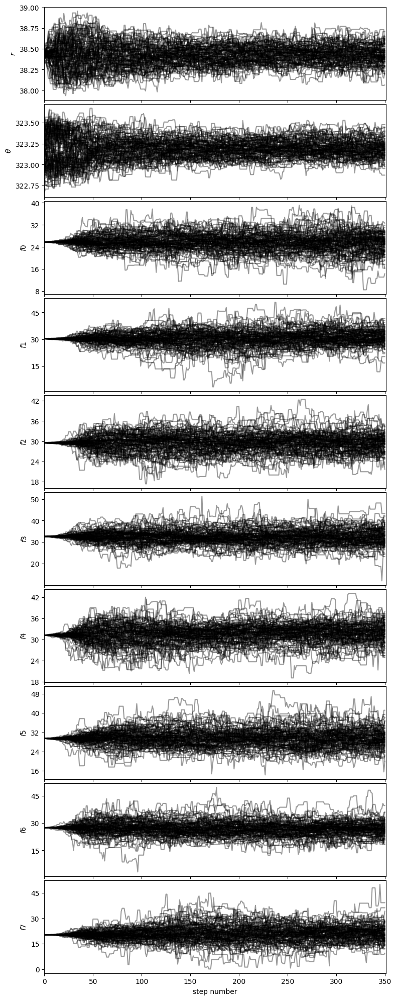

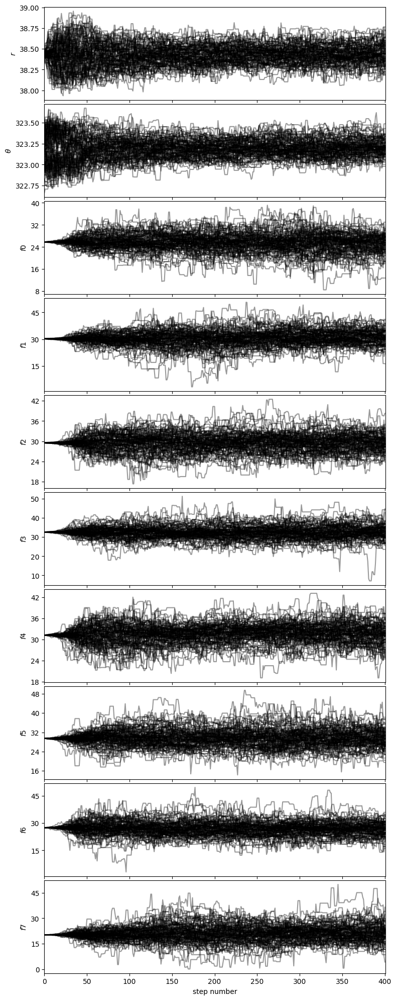

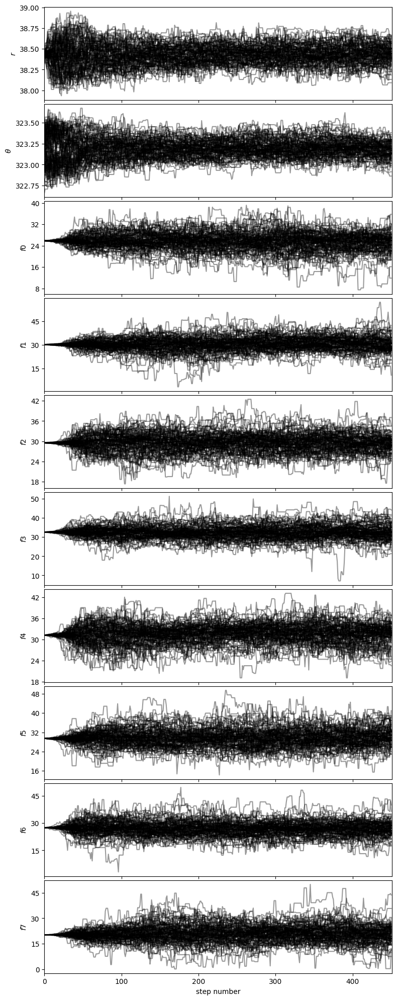

In [79]:
from vip_hci.fm import mcmc_negfc_sampling
chain = mcmc_negfc_sampling(cube_fc[final_chs_c], derot_angles, **obs_params, **algo_params, **negfc_params, 
                            initial_state=initial_state, **mcmc_params, **conv_params, weights=weights,
                            display=True, verbosity=2, save=False, output_dir='./')

If you ran the previous box and wish to write your results, set `write=True` in the next box. This will pickle the MCMC chain.

In [80]:
write=False

if write:
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'wb') as fileSave:
        pickle.dump(output, fileSave)

In [81]:
with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'rb') as fi:
    myPickler = pickle.Unpickler(fi)
    mcmc_result = myPickler.load()

chain = mcmc_result['chain']

Let's visualize the chain after setting labels for each parameter:

In [82]:
labels = [r"$r$", r"$\theta$"]
for i, ch in enumerate(final_chs_c):
    labels.append(r"$f$ (ch.{:.0f})".format(ch))

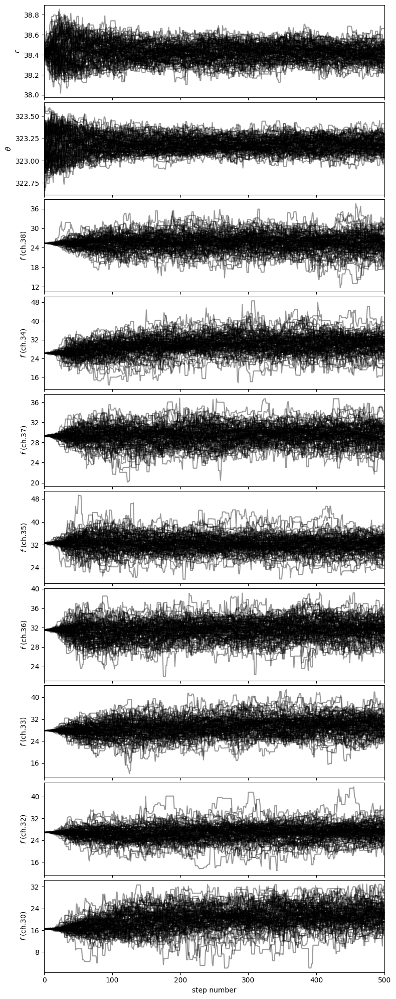

In [83]:
from vip_hci.fm import show_walk_plot
show_walk_plot(chain, labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

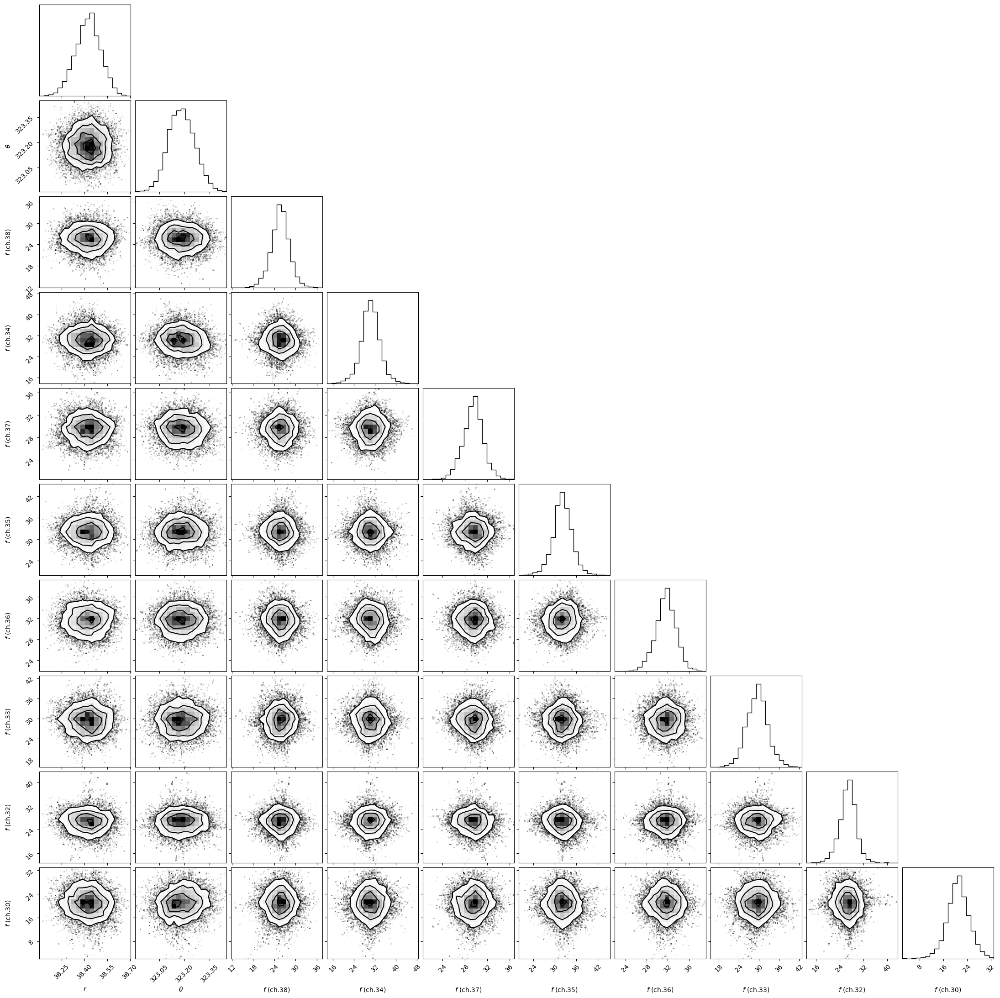

In [84]:
from vip_hci.fm import show_corner_plot
burnin = 0.3
show_corner_plot(chain, burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [85]:
npar = len(initial_state)
isamples_flat = chain[:, int(chain.shape[1]//(1/burnin)):, :].reshape((-1,npar))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

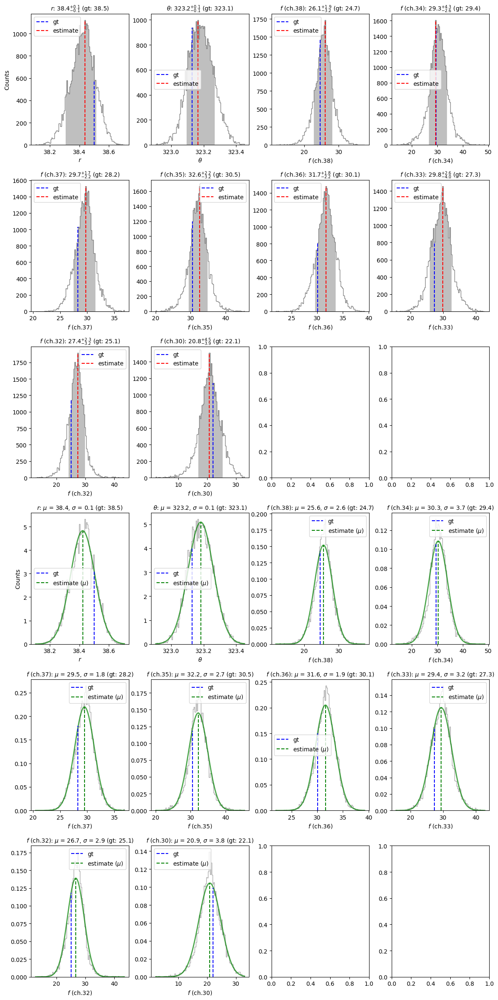

In [86]:
from vip_hci.fm import confidence

gt = [r_c, theta_c%360]
for i, ch in enumerate(final_chs_c):
    gt.append(flux_c_scal[ch])

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated parameters are consistent with the ground truth values (shown with dashed blue lines), within uncertainties.

In [87]:
from vip_hci.var import frame_center
r_est = mu[0]
theta_est = mu[1]

xc, yc = frame_center(cube_fc)
x_est = xc + r_est*np.cos(np.deg2rad(theta_est))
y_est = yc + r_est*np.sin(np.deg2rad(theta_est))

xy_est = (x_est, y_est)

## 7.7. Spectrum retrieval

### 7.7.1. NEGFC+PCA-ADI (simplex)

Let's use the negative fake companion technique (combined with PCA-ADI) to estimate the flux of the companion in each spectral channel. In this section, we will just use the `firstguess` function in VIP which finds a first estimate on a grid of flux values followed by a simplex. The difference with Sec. 7.6 is that here we set `force_rPA=True` to pin the position during the NEGFC procedure (i.e. only allowing the fluxes at different wavelengths as free parameters) - this will be faster and provide more reliable flux estimates in channels where the companion is faint.

In [88]:
est_fluxes_c = np.zeros(nch)
for i in range(nch):
    trans_i = np.array([trans[0],trans[i]])
    res = firstguess(cube_fc[i], derot_angles, psfn[i], ncomp=4, planets_xy_coord=[xy_est], 
                     fwhm=fwhm[i], annulus_width=int(4*fwhm[i]), aperture_radius=2, imlib=imlib, interpolation=interpolation,
                     f_range=None, transmission=trans_i, mu_sigma=True, force_rPA=True, weights=X_fac,
                     simplex=True, plot=False, verbose=False)
    _, _, est_fluxes_c[i] = res

<div class="alert alert-block alert-info"> 
    <b>Note: </b>
<a class="anchor" id="note1"></a>

Here we arbitrarily assigned the number of principal components to 4 for the PCA-ADI algorithm used by NEGFC to measure the flux of the outer fake planet. A more rigorous approach would consist in finding the optimal number of principal components for each spectral channel first, as done in [Tutorial 5A (Sec. 5.2)](https://vip.readthedocs.io/en/latest/tutorials/05_fm_planets.html#5.2.-Generating-and-injecting-synthetic-planets) or in the next section. 
</div>

Let's now compare the retrieved fluxes with and without weights to the ground truth values used for injection:

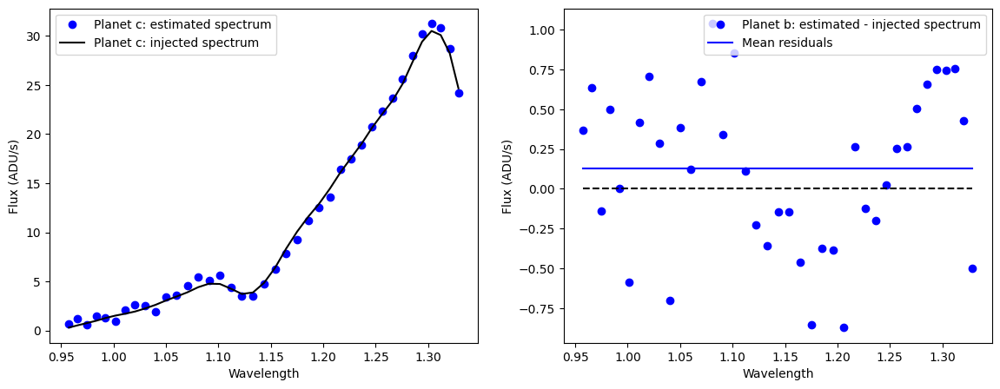

In [89]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, est_fluxes_c, 'bo', label='Planet c: estimated spectrum')
ax1.plot(lbda, flux_c_scal, 'k', label='Planet c: injected spectrum')
ax1.set_xlabel("Wavelength")
ax1.set_ylabel("Flux (ADU/s)")
ax1.legend()

ax2.plot(lbda, est_fluxes_c-flux_c_scal, 'bo', label='Planet b: estimated - injected spectrum')
ax2.plot(lbda, [0]*len(lbda), 'k--')
ax2.plot(lbda, [np.mean(est_fluxes_c-flux_c_scal)]*len(lbda), 'b-', label='Mean residuals')
ax2.set_xlabel("Wavelength")
ax2.set_ylabel("Flux (ADU/s)")
ax2.legend()
plt.show()

This approach does not yield uncertainties. For the latter, it is recommended to run the `mcmc_negfc_sampling` function.

### 7.7.2. NEGFC+PCA-ADI (MCMC)

One can use the MCMC approach to have both estimates and uncertainties on the flux of directly imaged companions. Given that this approach is computationally expensive, we will only apply it to 3 spectral channels. Again, we set `force_rPA=True` to pin the position during the NEGFC procedure as found from the spectral channels where the companions showed the highest SNR.

We refer to [Tutorial 5 (Sec. 5.3.3.)](https://vip.readthedocs.io/en/latest/tutorials/05A_fm_planets.html#5.3.3.-NEGFC-technique-coupled-with-MCMC) for more details on setting the MCMC parameters.

In [90]:
ann_width = 4*np.mean(fwhm)
aperture_radius=2
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': None}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

<div class="alert alert-block alert-info"> 
    <b>Note: </b>
<a class="anchor" id="note1"></a>

The pixel intensities in calibrated SPHERE cubes coming out from the DRH pipeline (as this one) are normalized by their integration time. In absence of knowledge of this original integration time, it is not possible to scale the cube back to original ADU values, and it is therefore not possible to include photon noise uncertainty among the different sources of uncertainty (in this specific case, the estimated photon noise uncertainty will be so large that the MCMC will not work properly). To alleviate this issue, we set `sigma` to 'spe', instead of 'spe+pho' (default) - although this may slightly underestimate the final uncertainties.
</div>

In [91]:
import pickle

lab='c'
test_ch = [20,29,38]

<div class="alert alert-block alert-warning"> 
    <b>Warning: </b>
<a class="anchor" id="note1"></a>

The next box is very computer-intensive. The results from that box have been saved in the 'datasets' folder, such that it can be skipped.
</div>

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-09 07:49:50
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.014893
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=6.977
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 30.0
Flux in a centered 1xFWHM circular aperture = 1.942
Central pixel S/N = 8.017
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.579
Max S/N (shifting the aperture center) = 9.557
stddev S/N (shifting the aperture center) = 1.654



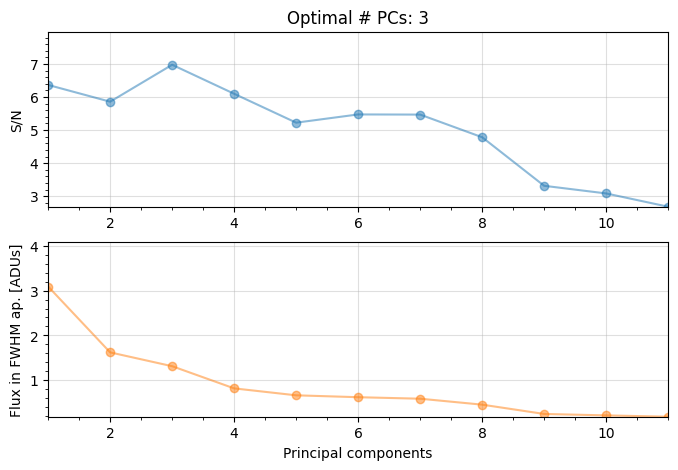

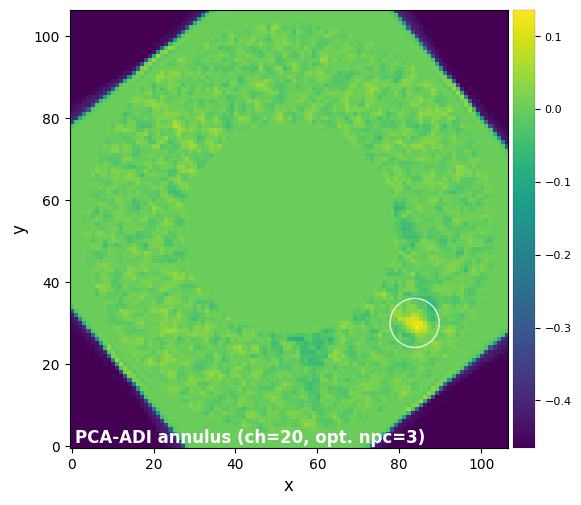

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-09 07:49:52
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.076
2/30   0.149   0.076
3/30   0.221   0.074
4/30   0.329   0.073
5/30   0.489   0.070
6/30   0.728   0.067
7/30   1.083   0.062
8/30   1.610   0.056
9/30   2.395   0.047
10/30   3.562   0.037
11/30   5.298   0.029
12/30   7.880   0.033
13/30   11.721   0.067
14/30   17.433   0.203


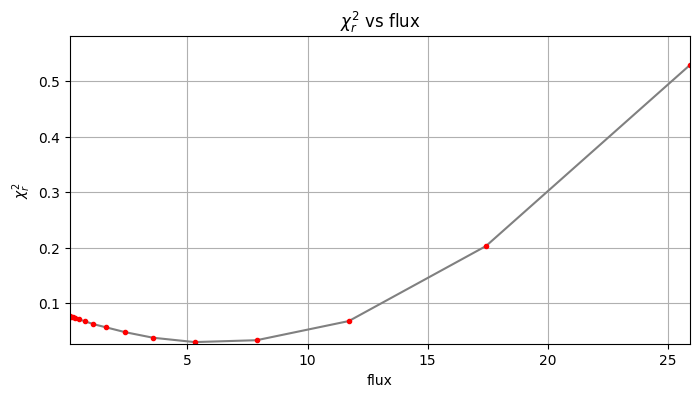

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 5.3
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 21, nfev: 48, chi2r: 0.02870798428148494
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 5.920) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:12.043463
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-09 07:50:04
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean and

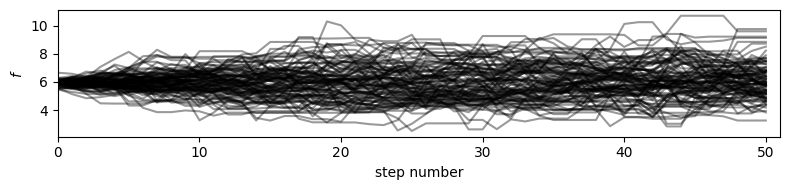

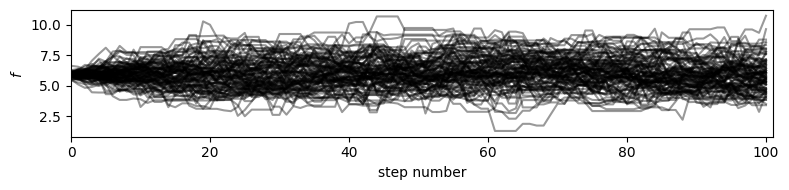

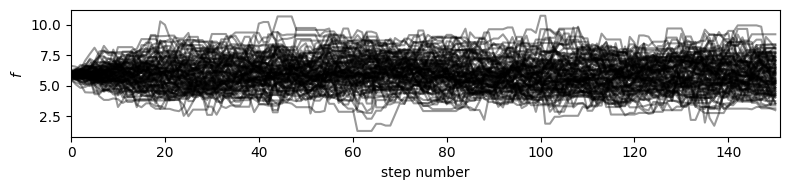

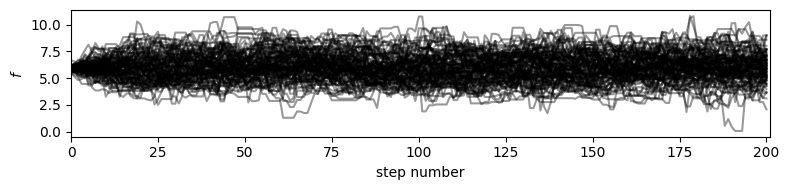

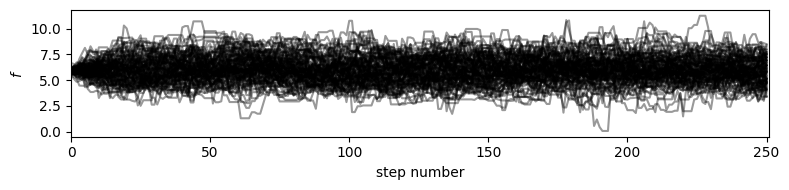

...

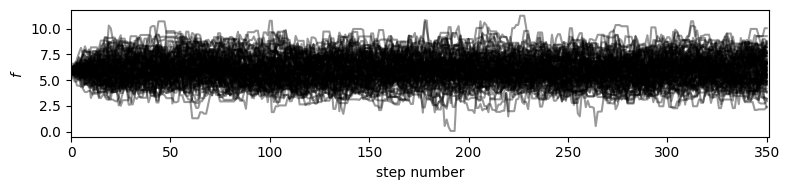

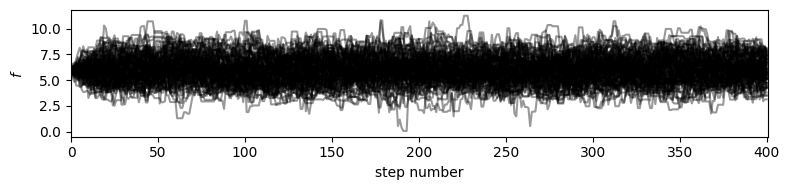

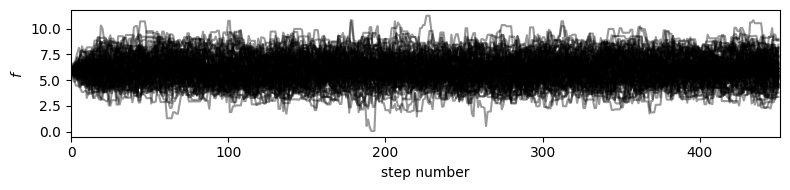

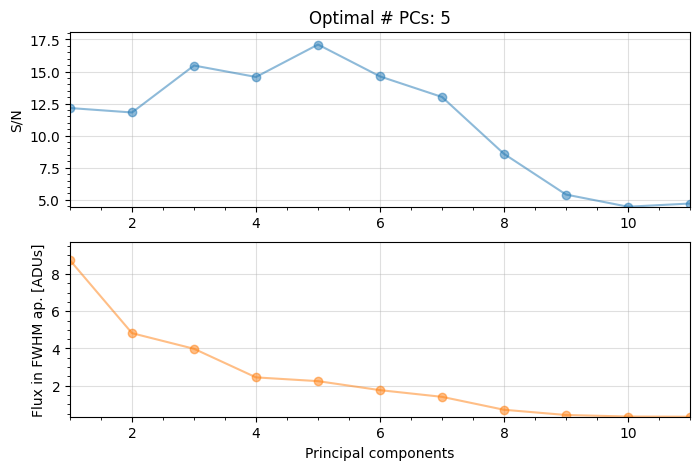

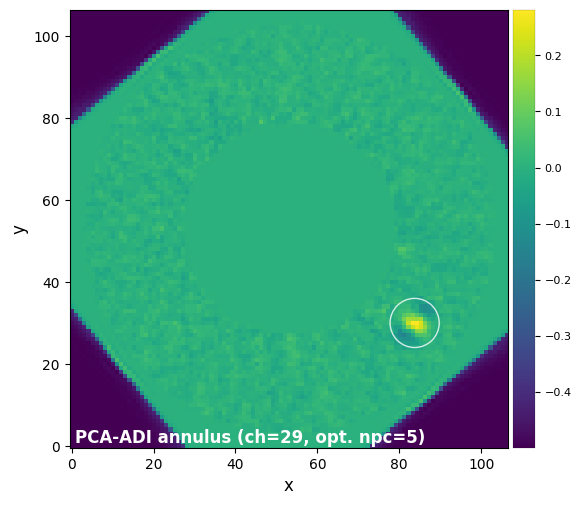

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-09 08:29:31
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.248
2/30   0.149   0.248
3/30   0.221   0.247
4/30   0.329   0.245
5/30   0.489   0.242
6/30   0.728   0.238
7/30   1.083   0.231
8/30   1.610   0.221
9/30   2.395   0.205
10/30   3.562   0.186
11/30   5.298   0.158
12/30   7.880   0.121
13/30   11.721   0.076
14/30   17.433   0.037
15/30   25.929   0.051
16/30   38.566   0.213
17/30   57.362   0.492


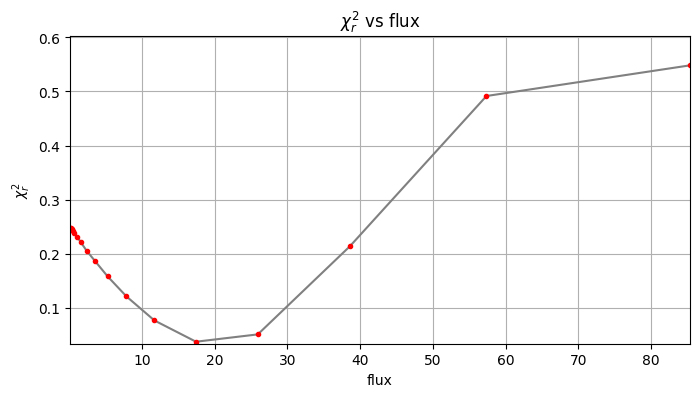

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 23, nfev: 51, chi2r: 0.031945210353584046
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 20.157) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:13.390550
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-09 08:29:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean 

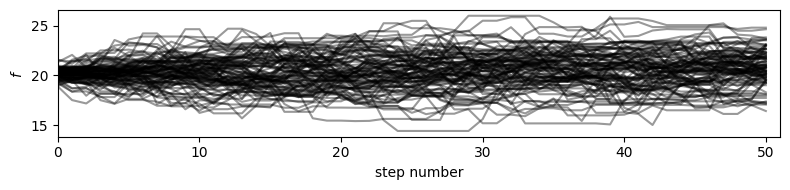

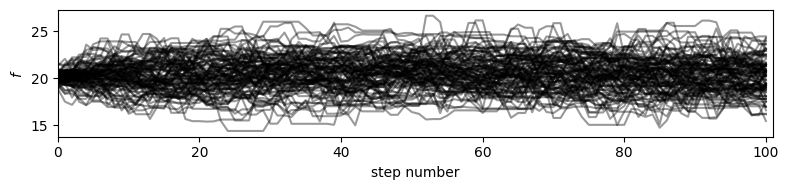

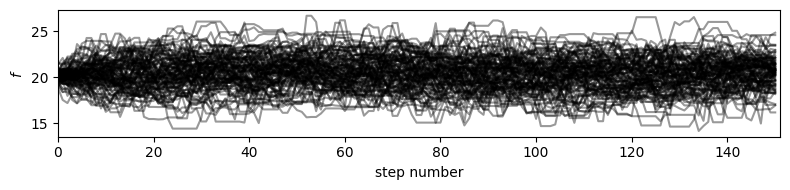

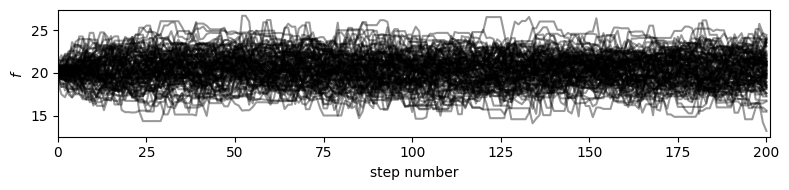

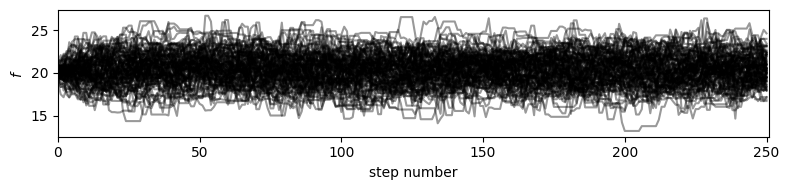

...

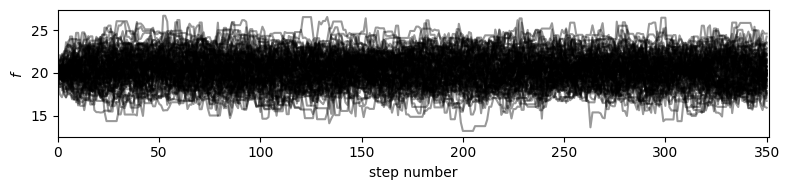

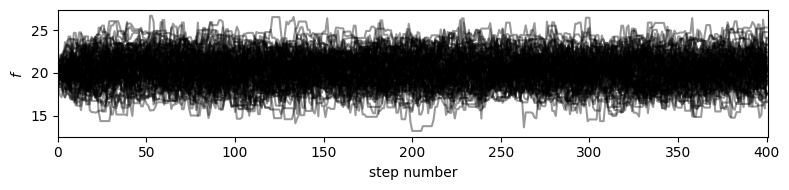

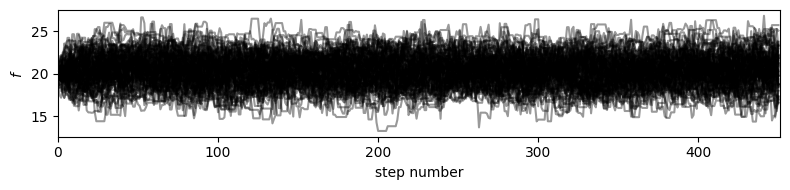

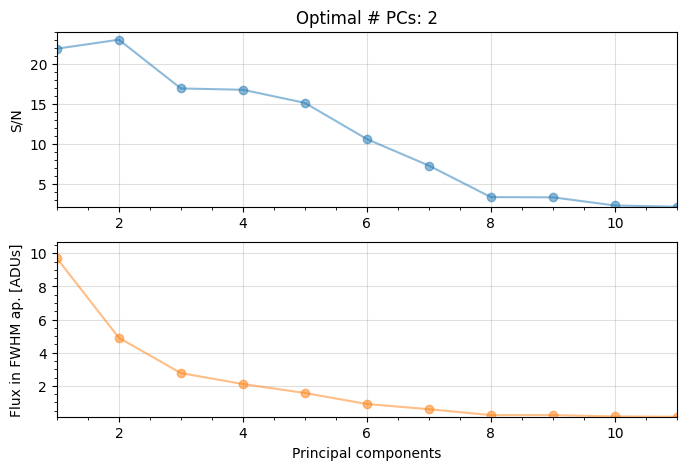

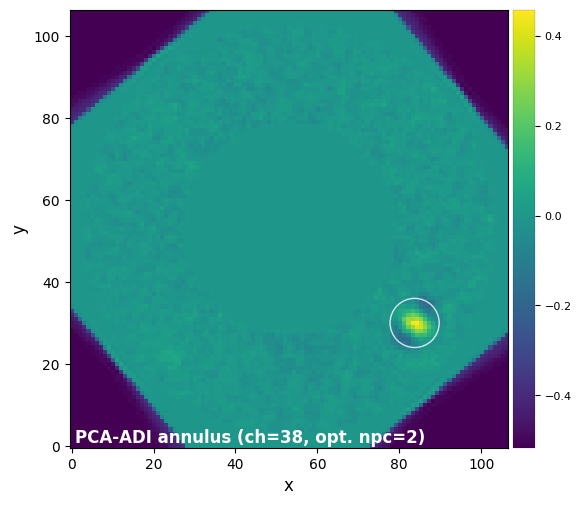

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-09 09:09:12
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.631
2/30   0.149   0.629
3/30   0.221   0.626
4/30   0.329   0.621
5/30   0.489   0.615
6/30   0.728   0.605
7/30   1.083   0.591
8/30   1.610   0.570
9/30   2.395   0.540
10/30   3.562   0.496
11/30   5.298   0.433
12/30   7.880   0.350
13/30   11.721   0.230
14/30   17.433   0.108
15/30   25.929   0.032
16/30   38.566   0.205
17/30   57.362   0.906
18/30   85.317   2.640


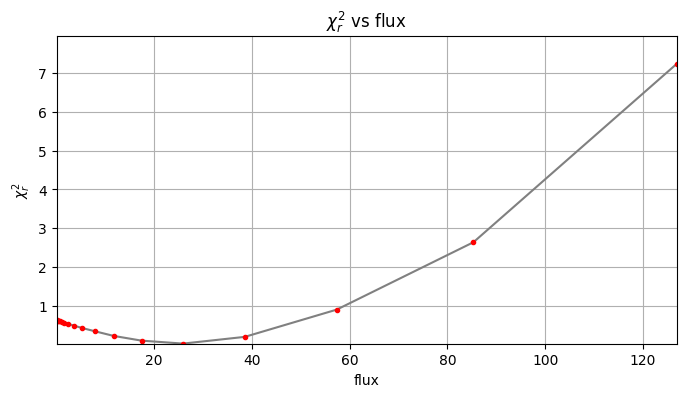

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 25.9
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 22, nfev: 49, chi2r: 0.03141176700592041
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 25.959) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:13.366227
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2024-07-09 09:09:26
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean a

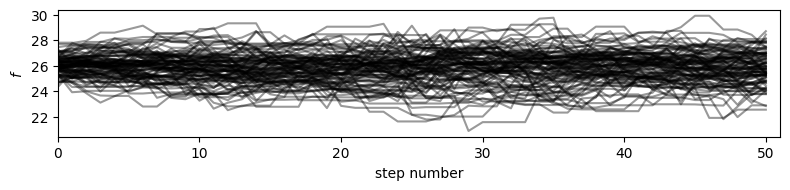

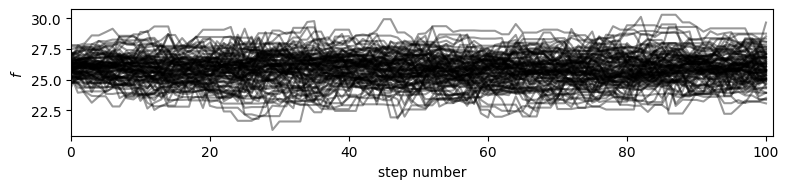

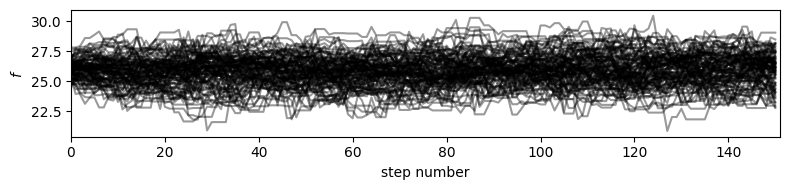

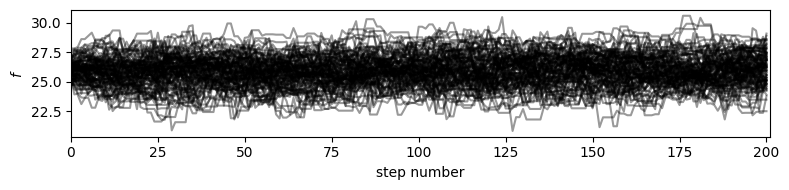

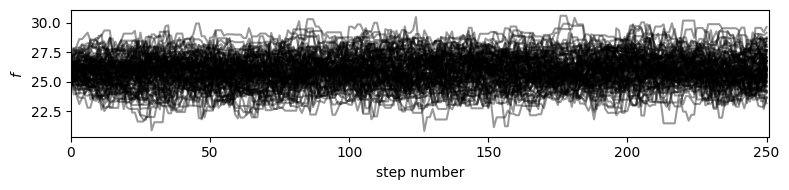

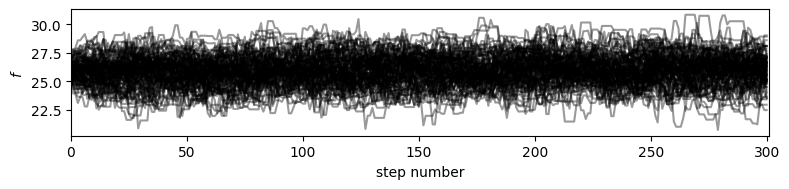

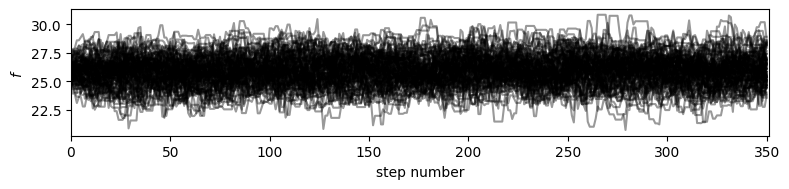

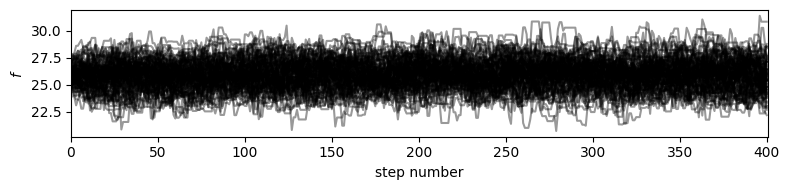

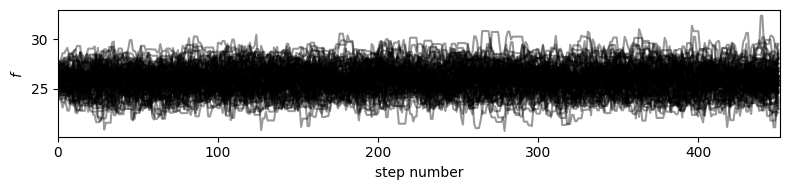

In [92]:
for i, ch in enumerate(test_ch):
    # find optimal npc
    res_ann_opt = pca_grid(cube_fc[ch], derot_angles, fwhm=fwhm[ch], range_pcs=(1,11,1), 
                           source_xy=xy_est, mode='annular',
                           annulus_width=ann_width, imlib=imlib, 
                           interpolation=interpolation, 
                           full_output=True, plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, _, opt_npc_ann = res_ann_opt
    plot_frames(final_ann_opt, label='PCA-ADI annulus (ch={}, opt. npc={:.0f})'.format(ch, opt_npc_ann),
                dpi=100, colorbar=True, circle=xy_est)
    # first guess
    trans_i = np.array([trans[0],trans[ch]])
    r_0, theta_0, f_0 = firstguess(cube_fc[ch], derot_angles, psfn[ch], ncomp=opt_npc_ann,
                                   planets_xy_coord=[xy_est], fwhm=fwhm[ch], weights=X_fac,
                                   f_range=None, annulus_width=ann_width, aperture_radius=aperture_radius,
                                   imlib=imlib, interpolation=interpolation, simplex=True, force_rPA=True,
                                   transmission=trans_i, plot=True, verbose=True)
    initial_state = np.array([r_0[0], theta_0[0], f_0[0]])
    # MCMC
    obs_params['psfn']= psfn[ch]
    obs_params['fwhm']= fwhm[ch]
    obs_params['transmission']= trans_i
    algo_params['ncomp'] = opt_npc_ann
    chain = mcmc_negfc_sampling(cube_fc[ch], derot_angles, **obs_params, **algo_params, **negfc_params, 
                                initial_state=initial_state, **mcmc_params, **conv_params, weights=X_fac,
                                force_rPA=True, display=True, verbosity=2, save=False, output_dir='./')
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'wb') as fileSave:
        pickle.dump(output, fileSave)           

In [93]:
chain = []
for i, ch in enumerate(test_ch):

    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'rb') as fi:
        myPickler = pickle.Unpickler(fi)
        mcmc_result = myPickler.load()

    chain.append(mcmc_result['chain'])

Let's visualize the chain after setting labels for each parameter:

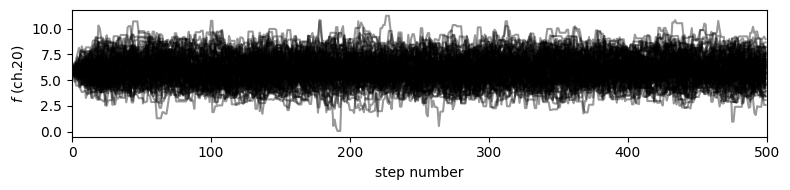

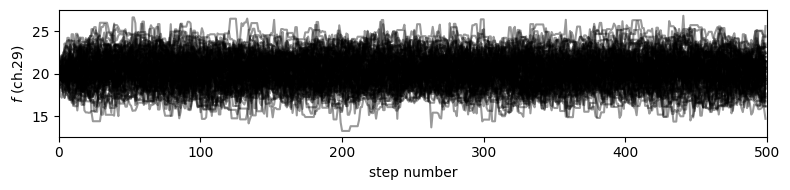

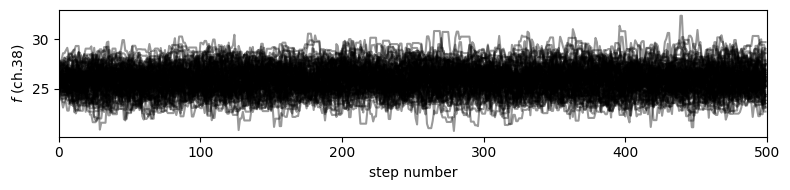

In [94]:
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_walk_plot(chain[i], labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

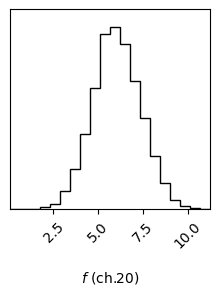

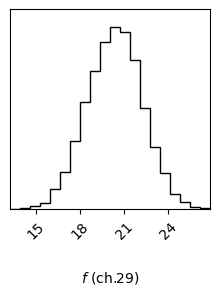

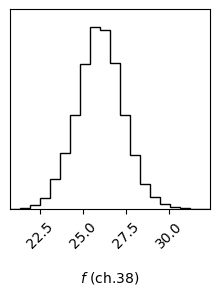

In [95]:
burnin = 0.3
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_corner_plot(chain[i], burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [96]:
npar = 1

In [97]:
isamples_flat = chain[0][:, int(chain[0].shape[1]//(1/burnin)):, :].reshape((-1,npar))
for i in range(1,len(test_ch)):
    isamples_flat = np.hstack((isamples_flat, 
                               chain[i][:, int(chain[i].shape[1]//(1/burnin)):, :].reshape((-1,npar))))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

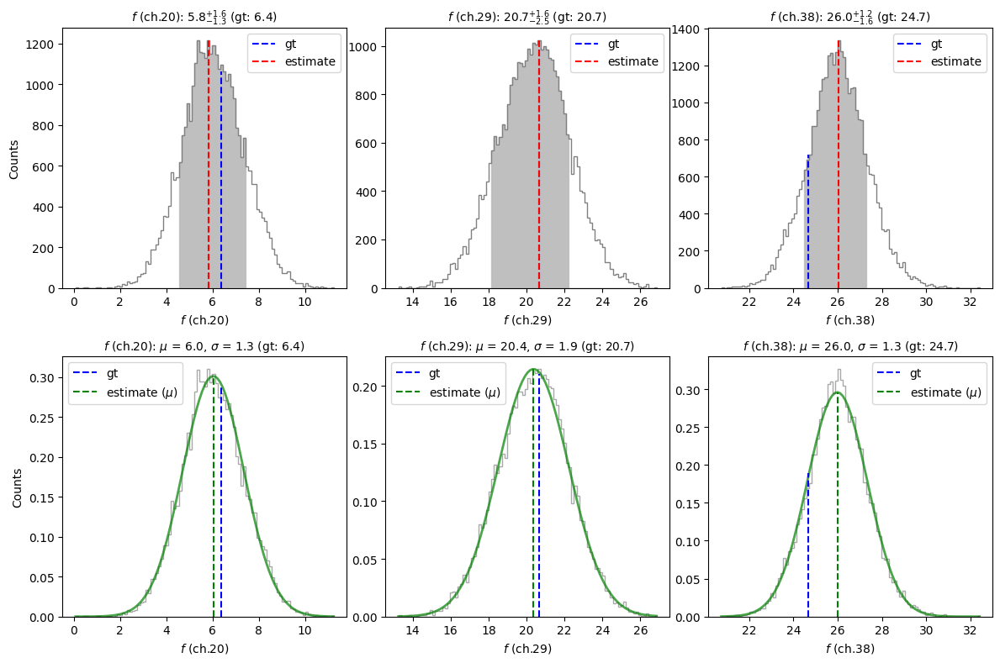

In [98]:
gt = []
labels = []
for i, ch in enumerate(test_ch):
    gt.append(flux_c_scal[ch])
    labels.append(r"$f$ (ch.{:.0f})".format(ch))

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated fluxes are consistent with the ground truth values (shown with dashed blue lines), within uncertainties.